In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip install opendatasets pandas
!pip install evaluate datasets
!pip install transformers[torch] accelerate -U
!pip install rasterio

In [ ]:
# unzip the folder and save the data
!unzip /content/drive/MyDrive/boundary_demarcation/Planet/DATA_full/planet_patches_png.zip -d /content/drive/MyDrive/boundary_demarcation/Planet/DATA_full/Images
!unzip /content/drive/MyDrive/boundary_demarcation/Planet/DATA_full/planet_masks_png.zip -d /content/drive/MyDrive/boundary_demarcation/Planet/DATA_full/Masks

In [ ]:
# import libraries
import cv2
import tifffile
from pathlib import Path
import shutil
import concurrent.futures
from sklearn.model_selection import train_test_split
import numpy as np
import torch
import torch.nn as nn
import torch.utils.data as data
from transformers import (
    SegformerForSemanticSegmentation,
    TrainingArguments, Trainer,
    SegformerImageProcessor)
from datasets import Dataset, Image
import evaluate
import matplotlib.pyplot as plt

In [ ]:
plt.rcParams['figure.figsize'] = 12, 12

In [ ]:
DATA_DIR = Path('/content/drive/MyDrive/boundary_demarcation/Planet/DATA_full')

In [ ]:
# Pre-trained models
MODEL_CHECKPOINT = 'nvidia/mit-b4'


VAL_SIZE = 0.2
BATCH_SIZE = 4
EPOCHS = 10
LR = 0.00006

IMG_SIZE = 512

## Data processing

In [ ]:
# Combine the base directory with the 'Images' subdirectory
images_path = DATA_DIR / 'Images'
images = list(images_path.glob('**/*.png'))
images = [str(path) for path in images]
print(f'{len(images)} images detected.')

# Combine the base directory with the 'Masks' subdirectory
masks_path = DATA_DIR / 'Masks'
masks = list(masks_path.glob('**/*.png'))
masks = [str(path) for path in masks]
print(f'{len(masks)} masks detected.')

1053 images detected.
1053 masks detected.


In [ ]:
# Ensure the image and mask paths are sorted consistently
images.sort()
masks.sort()

In [ ]:
# Split the data into train and validation sets

train_images, val_images, train_masks, val_masks = train_test_split(
    images, masks, test_size=VAL_SIZE, random_state=0, shuffle=True)
print(f'Train images: {len(train_images)}\nValidation images: {len(val_images)}')

Train images: 842
Validation images: 211


In [ ]:
# check the training masks
train_masks

In [ ]:
def create_dataset(image_paths, mask_paths):
    dataset = Dataset.from_dict({'pixel_values': image_paths,
                                 'label': mask_paths})
    dataset = dataset.cast_column('pixel_values', Image())
    dataset = dataset.cast_column('label', Image())
    return dataset


ds_train = create_dataset(train_images, train_masks)
ds_valid = create_dataset(val_images, val_masks)

In [ ]:
ds_train

Dataset({
    features: ['pixel_values', 'label'],
    num_rows: 842
})

In [ ]:
ds_valid

Dataset({
    features: ['pixel_values', 'label'],
    num_rows: 211
})

### display and check images and masks

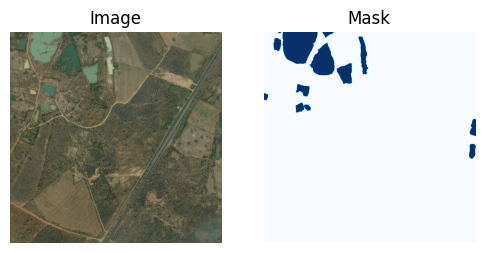

In [ ]:
import cv2
import matplotlib.pyplot as plt

# Path to the image file
image_path = '/content/drive/MyDrive/boundary_demarcation/results/water/53987_image.tif'

# Path to the image file
mask_path = '/content/drive/MyDrive/boundary_demarcation/results/water/53987_mask.png'


# Read the image using tifffile
image = tifffile.imread(image_path)
# Read the image using OpenCV
mask = cv2.imread(mask_path, cv2.IMREAD_UNCHANGED)


fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(6, 6))

# Display the image
ax1.imshow(image)
ax1.set_title('Image')
ax1.axis('Off')  # Turn off axis


# Display the image
# ax2.imshow(mask)
ax2.imshow(mask, cmap='Blues')
ax2.set_title('Mask')
ax2.axis('Off')  # Turn off axis

# Show the plot
plt.show()

In [ ]:
np.unique(mask)

array([0, 1], dtype=uint8)

In [ ]:
# Get the properties of the image
height, width, channels = image.shape
data_type = image.dtype

print(f'Image Dimensions: {width}x{height}')
print(f'Number of Channels: {channels}')
print(f'Data Type: {data_type}')

Image Dimensions: 2448x2448
Number of Channels: 3
Data Type: uint8


## .

In [ ]:
# Image preprocessing native to the pretrained model.
feature_extractor = SegformerImageProcessor.from_pretrained(MODEL_CHECKPOINT)

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


preprocessor_config.json:   0%|          | 0.00/272 [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/transformers/utils/deprecation.py:165: UserWarning: The following named arguments are not valid for `SegformerImageProcessor.__init__` and were ignored: 'feature_extractor_type'
  return func(*args, **kwargs)


In [ ]:
# apply transformations to the image
def apply_transforms(batch):
    images = [x for x in batch['pixel_values']]
    labels = [x for x in batch['label']]
    inputs = feature_extractor(images, labels)
    return inputs


ds_train.set_transform(apply_transforms)
ds_valid.set_transform(apply_transforms)

In [ ]:
ds_train, ds_valid

(Dataset({
     features: ['pixel_values', 'label'],
     num_rows: 842
 }),
 Dataset({
     features: ['pixel_values', 'label'],
     num_rows: 211
 }))

## Model Training

In [ ]:
# for rgb water
id2label = {0: 'background', 1: 'water'}

label2id = {label: id for id, label in id2label.items()}
num_labels = len(id2label)

model = SegformerForSemanticSegmentation.from_pretrained(
    MODEL_CHECKPOINT,
    num_labels=num_labels,
    id2label=id2label,
    label2id=label2id,
    ignore_mismatched_sizes=True,
)

config.json:   0%|          | 0.00/70.0k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/246M [00:00<?, ?B/s]

Some weights of SegformerForSemanticSegmentation were not initialized from the model checkpoint at nvidia/mit-b4 and are newly initialized: ['decode_head.batch_norm.bias', 'decode_head.batch_norm.num_batches_tracked', 'decode_head.batch_norm.running_mean', 'decode_head.batch_norm.running_var', 'decode_head.batch_norm.weight', 'decode_head.classifier.bias', 'decode_head.classifier.weight', 'decode_head.linear_c.0.proj.bias', 'decode_head.linear_c.0.proj.weight', 'decode_head.linear_c.1.proj.bias', 'decode_head.linear_c.1.proj.weight', 'decode_head.linear_c.2.proj.bias', 'decode_head.linear_c.2.proj.weight', 'decode_head.linear_c.3.proj.bias', 'decode_head.linear_c.3.proj.weight', 'decode_head.linear_fuse.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [ ]:
metric = evaluate.load('mean_iou')


def compute_metrics(eval_pred):
    with torch.no_grad():
        logits, labels = eval_pred
        logits_tensor = torch.from_numpy(logits)
        # scale the logits to the size of the label
        logits_tensor = nn.functional.interpolate(
            logits_tensor,
            size=labels.shape[-2:],
            mode='bilinear',
            align_corners=False,
        ).argmax(dim=1)

        pred_labels = logits_tensor.detach().cpu().numpy()
        metrics = metric._compute(
                predictions=pred_labels,
                references=labels,
                num_labels=len(id2label),
                ignore_index=0,
                reduce_labels=feature_extractor.do_reduce_labels,
            )

        # add per category metrics as individual key-value pairs
        per_category_accuracy = metrics.pop("per_category_accuracy").tolist()
        per_category_iou = metrics.pop("per_category_iou").tolist()

        metrics.update({f"accuracy_{id2label[i]}": v for i, v in enumerate(per_category_accuracy)})
        metrics.update({f"iou_{id2label[i]}": v for i, v in enumerate(per_category_iou)})

        return metrics

In [ ]:
training_args = TrainingArguments(
    'segformer_finetuned_water_planet_RGB_fullimage_2607',
    learning_rate=LR,
    num_train_epochs=EPOCHS,
    per_device_train_batch_size=BATCH_SIZE,
    per_device_eval_batch_size=BATCH_SIZE,
    save_total_limit=3,
    evaluation_strategy='steps',
    save_strategy='steps',
    save_steps=20,
    eval_steps=20,
    logging_steps=1,
    eval_accumulation_steps=5,
    load_best_model_at_end=True,
    push_to_hub=False,
    report_to='none'
)

In [ ]:
trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=ds_train,
    eval_dataset=ds_valid,
    compute_metrics=compute_metrics,
)

trainer.train()

Step,Training Loss,Validation Loss,Mean Iou,Mean Accuracy,Overall Accuracy,Accuracy Background,Accuracy Water,Iou Background,Iou Water
20,0.283400,0.346394,0.286124,0.572247,0.572247,nan,0.572247,0.000000,0.572247
40,0.185500,0.191680,0.339136,0.678271,0.678271,nan,0.678271,0.000000,0.678271
60,0.218500,0.160777,0.401657,0.803313,0.803313,nan,0.803313,0.000000,0.803313
80,0.183400,0.166234,0.391595,0.783190,0.783190,nan,0.783190,0.000000,0.783190
100,0.120900,0.151800,0.353063,0.706125,0.706125,nan,0.706125,0.000000,0.706125
120,0.096100,0.137837,0.382731,0.765462,0.765462,nan,0.765462,0.000000,0.765462
140,0.111700,0.132150,0.370757,0.741514,0.741514,nan,0.741514,0.000000,0.741514
160,0.135700,0.129375,0.359740,0.719479,0.719479,nan,0.719479,0.000000,0.719479
180,0.064700,0.136076,0.367063,0.734126,0.734126,nan,0.734126,0.000000,0.734126
200,0.171900,0.129215,0.372557,0.745115,0.745115,nan,0.745115,0.000000,0.745115


/root/.cache/huggingface/modules/evaluate_modules/metrics/evaluate-metric--mean_iou/9e450724f21f05592bfb0255fe2fa576df8171fa060d11121d8aecfff0db80d0/mean_iou.py:260: RuntimeWarning: invalid value encountered in divide
  acc = total_area_intersect / total_area_label
/root/.cache/huggingface/modules/evaluate_modules/metrics/evaluate-metric--mean_iou/9e450724f21f05592bfb0255fe2fa576df8171fa060d11121d8aecfff0db80d0/mean_iou.py:260: RuntimeWarning: invalid value encountered in divide
  acc = total_area_intersect / total_area_label
/root/.cache/huggingface/modules/evaluate_modules/metrics/evaluate-metric--mean_iou/9e450724f21f05592bfb0255fe2fa576df8171fa060d11121d8aecfff0db80d0/mean_iou.py:260: RuntimeWarning: invalid value encountered in divide
  acc = total_area_intersect / total_area_label
/root/.cache/huggingface/modules/evaluate_modules/metrics/evaluate-metric--mean_iou/9e450724f21f05592bfb0255fe2fa576df8171fa060d11121d8aecfff0db80d0/mean_iou.py:260: RuntimeWarning: invalid value encoun

Step,Training Loss,Validation Loss,Mean Iou,Mean Accuracy,Overall Accuracy,Accuracy Background,Accuracy Water,Iou Background,Iou Water
20,0.283400,0.346394,0.286124,0.572247,0.572247,nan,0.572247,0.000000,0.572247
40,0.185500,0.191680,0.339136,0.678271,0.678271,nan,0.678271,0.000000,0.678271
60,0.218500,0.160777,0.401657,0.803313,0.803313,nan,0.803313,0.000000,0.803313
80,0.183400,0.166234,0.391595,0.783190,0.783190,nan,0.783190,0.000000,0.783190
100,0.120900,0.151800,0.353063,0.706125,0.706125,nan,0.706125,0.000000,0.706125
120,0.096100,0.137837,0.382731,0.765462,0.765462,nan,0.765462,0.000000,0.765462
140,0.111700,0.132150,0.370757,0.741514,0.741514,nan,0.741514,0.000000,0.741514
160,0.135700,0.129375,0.359740,0.719479,0.719479,nan,0.719479,0.000000,0.719479
180,0.064700,0.136076,0.367063,0.734126,0.734126,nan,0.734126,0.000000,0.734126
200,0.171900,0.129215,0.372557,0.745115,0.745115,nan,0.745115,0.000000,0.745115


/root/.cache/huggingface/modules/evaluate_modules/metrics/evaluate-metric--mean_iou/9e450724f21f05592bfb0255fe2fa576df8171fa060d11121d8aecfff0db80d0/mean_iou.py:260: RuntimeWarning: invalid value encountered in divide
  acc = total_area_intersect / total_area_label
/root/.cache/huggingface/modules/evaluate_modules/metrics/evaluate-metric--mean_iou/9e450724f21f05592bfb0255fe2fa576df8171fa060d11121d8aecfff0db80d0/mean_iou.py:260: RuntimeWarning: invalid value encountered in divide
  acc = total_area_intersect / total_area_label
/root/.cache/huggingface/modules/evaluate_modules/metrics/evaluate-metric--mean_iou/9e450724f21f05592bfb0255fe2fa576df8171fa060d11121d8aecfff0db80d0/mean_iou.py:260: RuntimeWarning: invalid value encountered in divide
  acc = total_area_intersect / total_area_label
/root/.cache/huggingface/modules/evaluate_modules/metrics/evaluate-metric--mean_iou/9e450724f21f05592bfb0255fe2fa576df8171fa060d11121d8aecfff0db80d0/mean_iou.py:260: RuntimeWarning: invalid value encoun

TrainOutput(global_step=2110, training_loss=0.08440724123904914, metrics={'train_runtime': 7747.8164, 'train_samples_per_second': 1.087, 'train_steps_per_second': 0.272, 'total_flos': 2.5425388022582477e+18, 'train_loss': 0.08440724123904914, 'epoch': 10.0})

In [ ]:
# save the trained model
model.save_pretrained('/content/drive/MyDrive/MA/Models/segformer_finetuned_water_planet_RGB_fullimage_2607')

In [ ]:
id2label = {0: 'background', 1: 'water'}
label2id = {label: id for id, label in id2label.items()}
num_labels = len(id2label)

model = SegformerForSemanticSegmentation.from_pretrained(
   '/content/drive/MyDrive/MA/Models/segformer_finetuned_water_planet_RGB_fullimage_2607',
    num_labels=num_labels,
    id2label=id2label,
    label2id=label2id,
    ignore_mismatched_sizes=True,
)


feature_extractor = SegformerImageProcessor.from_pretrained(MODEL_CHECKPOINT)

## Visualise and compare the satellite image, true mask and predicted mask

Validation image #1


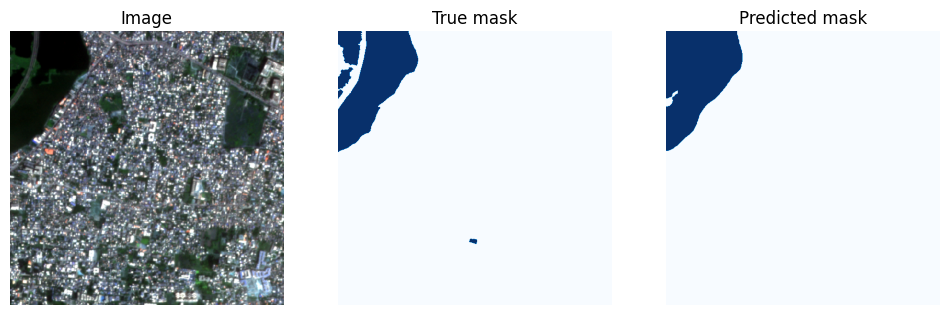

Validation image #2


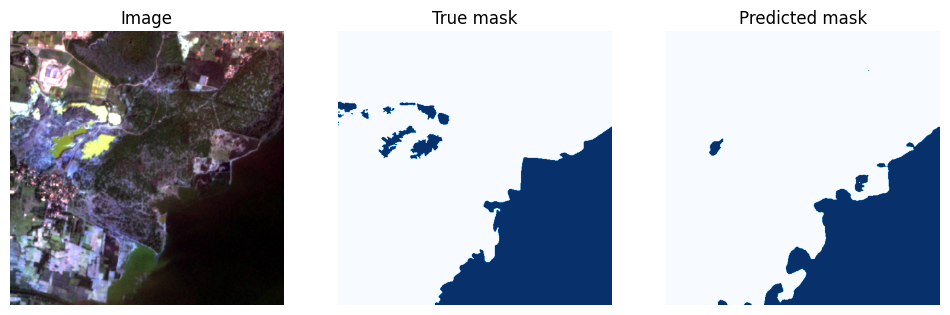

Validation image #3


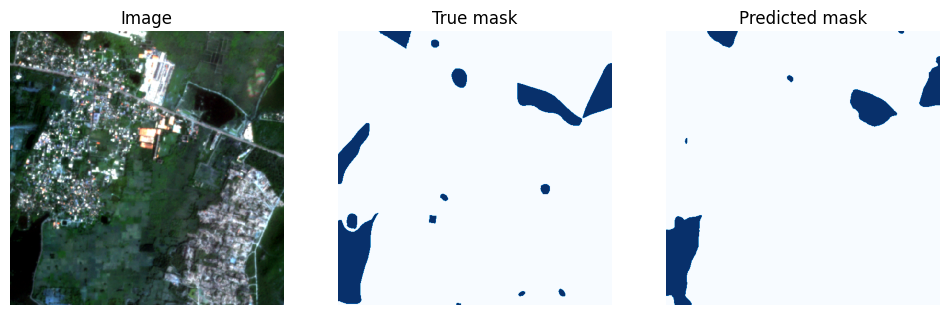

Validation image #4


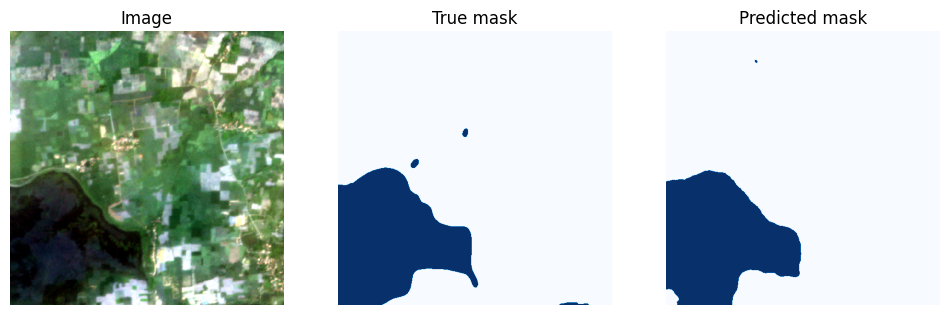

Validation image #5


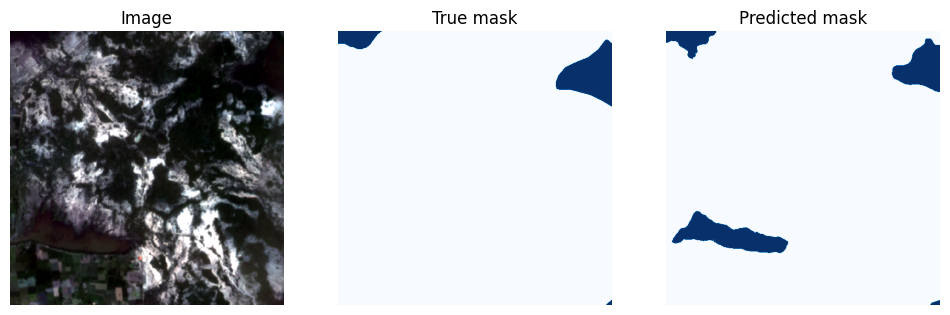

Validation image #6


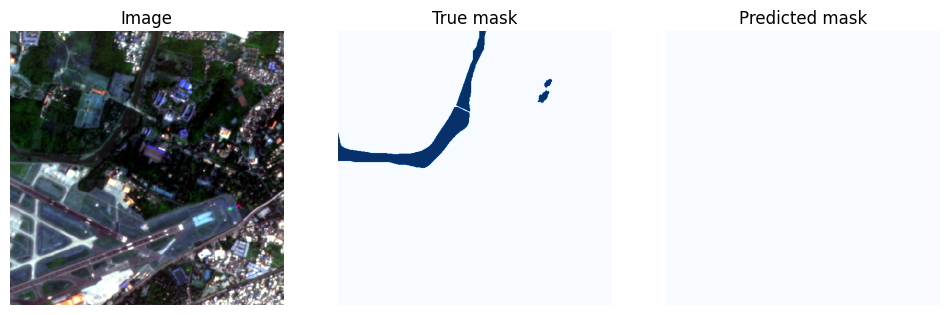

Validation image #7


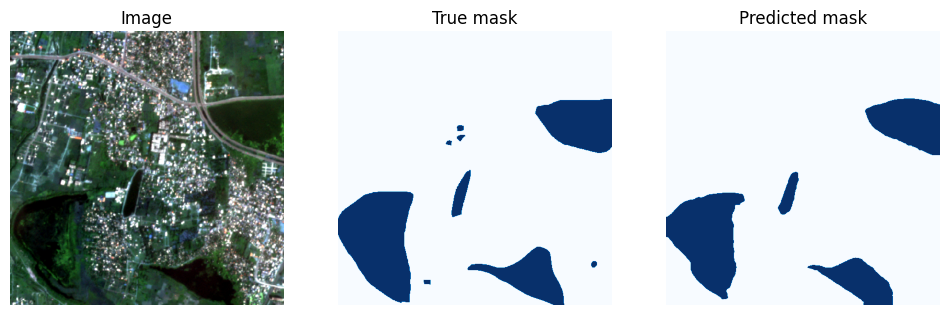

Validation image #8


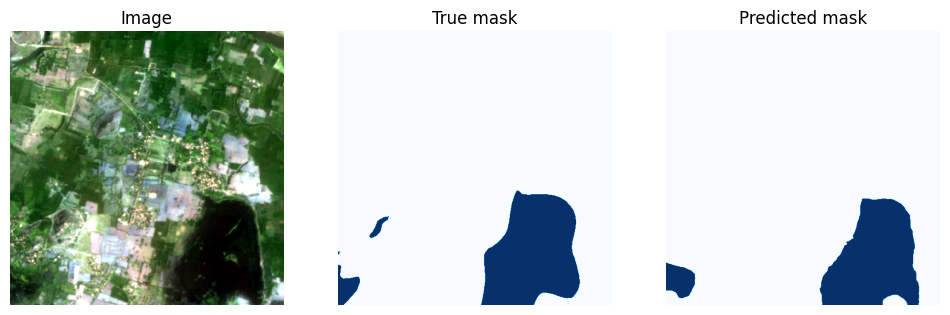

Validation image #9


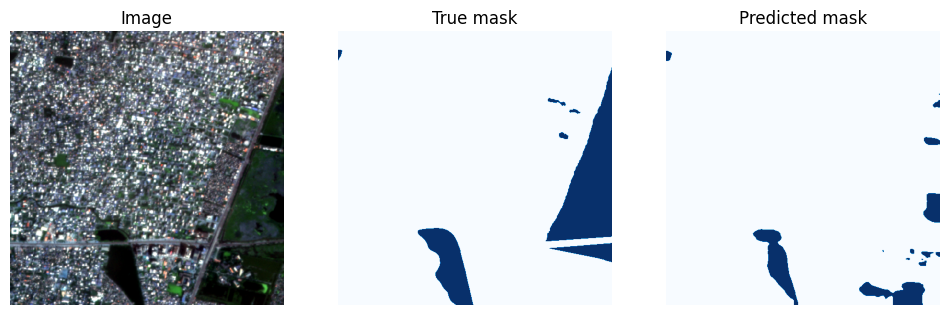

Validation image #10


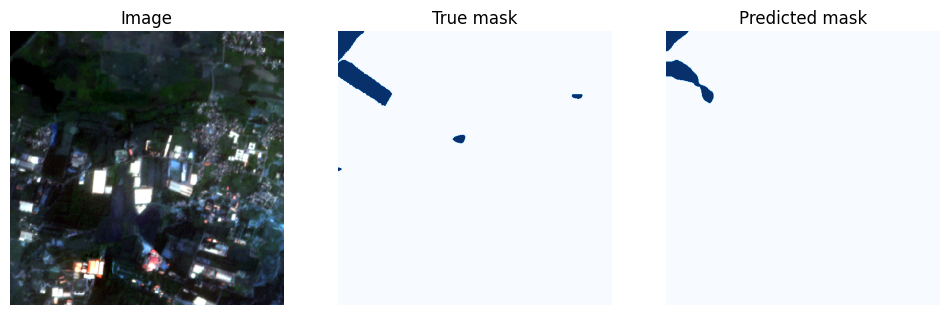

Validation image #11


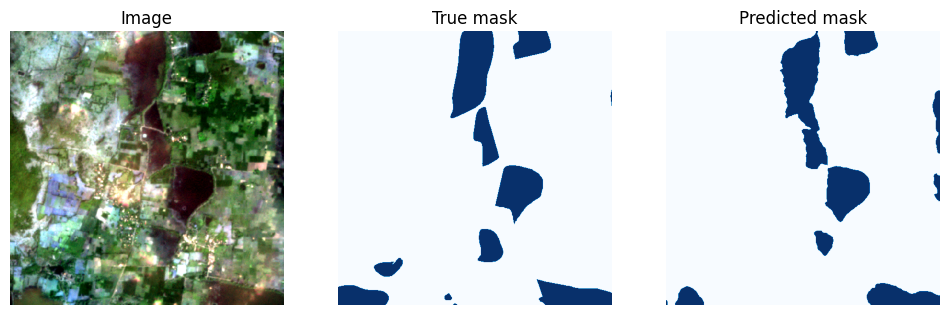

Validation image #12


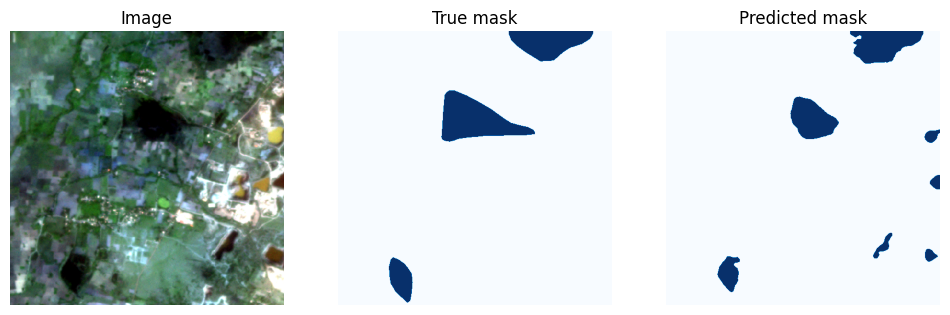

Validation image #13


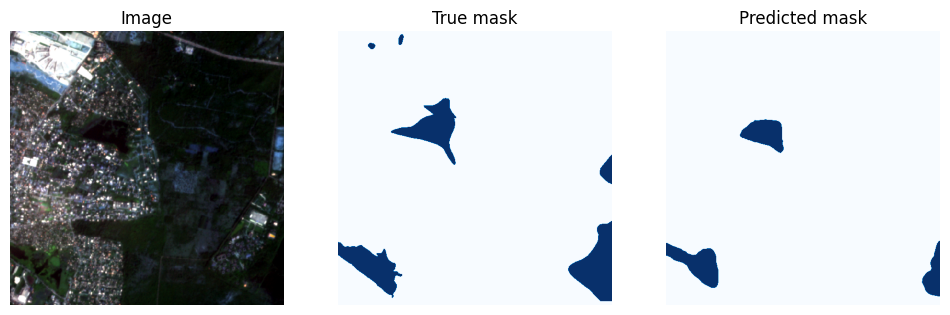

Validation image #14


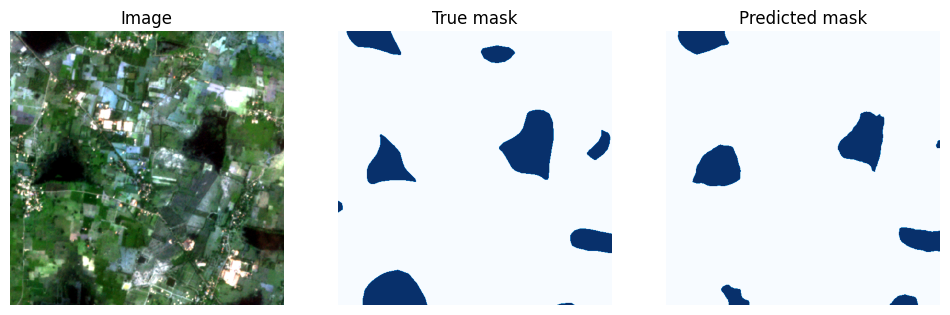

Validation image #15


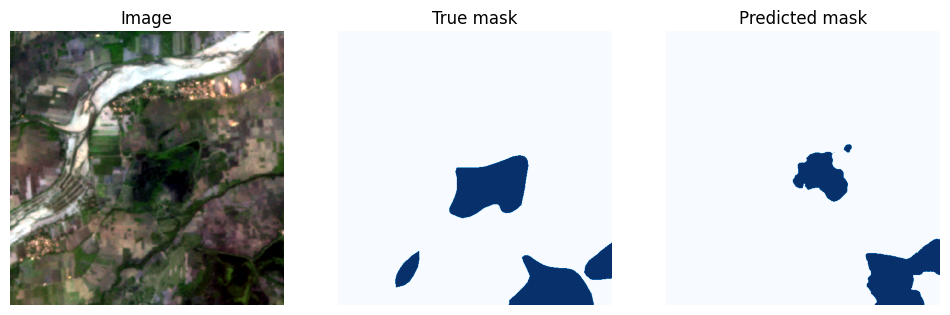

Validation image #16


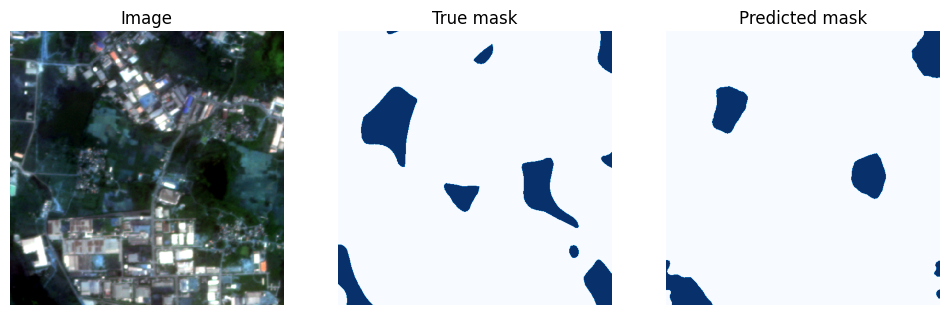

Validation image #17


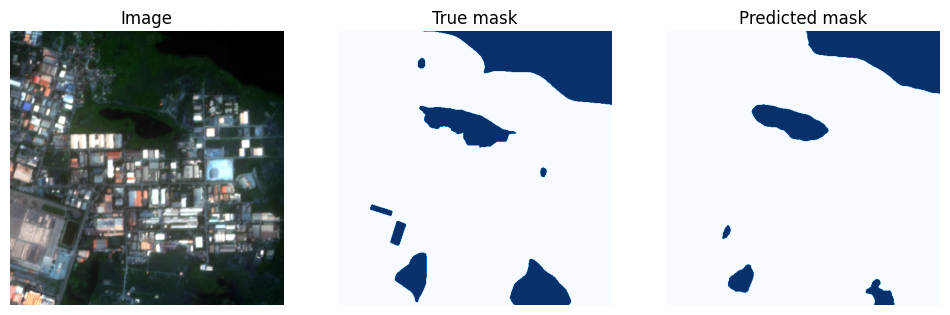

Validation image #18


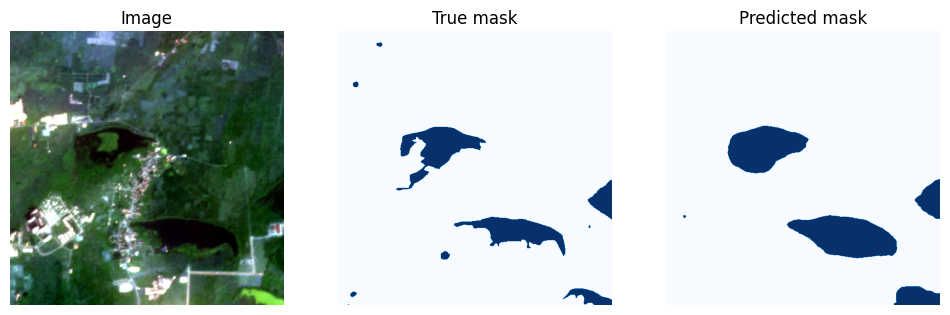

Validation image #19


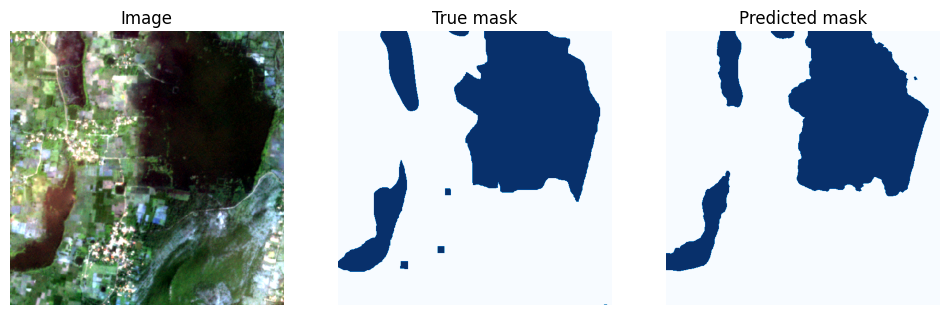

Validation image #20


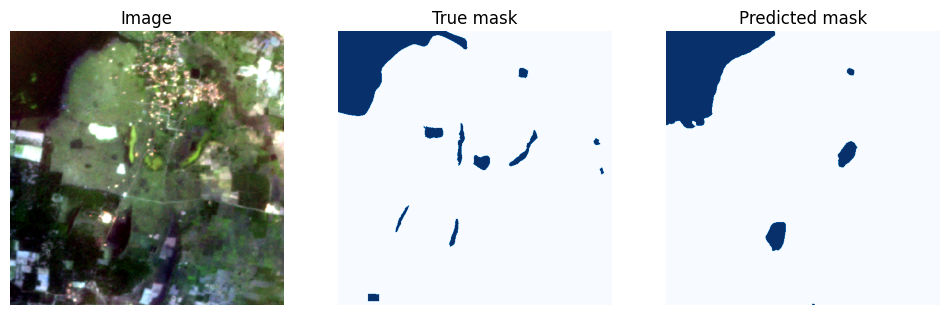

Validation image #21


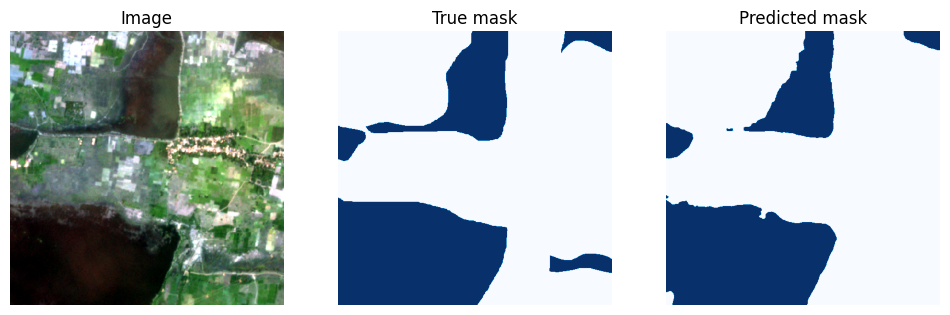

Validation image #22


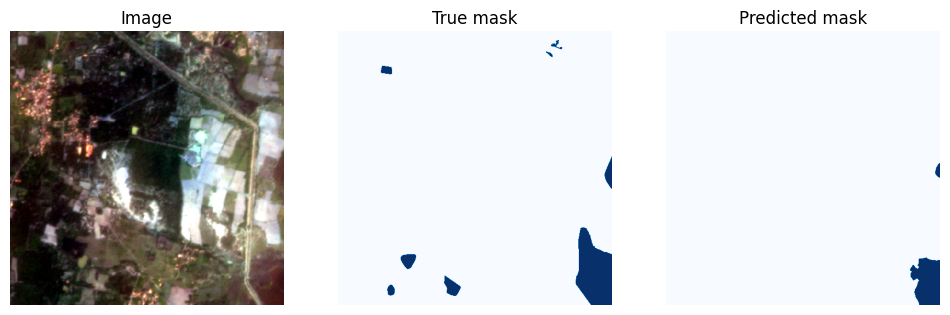

Validation image #23


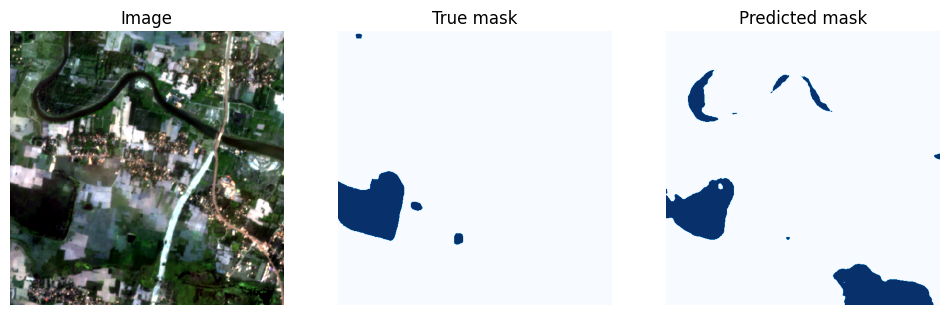

Validation image #24


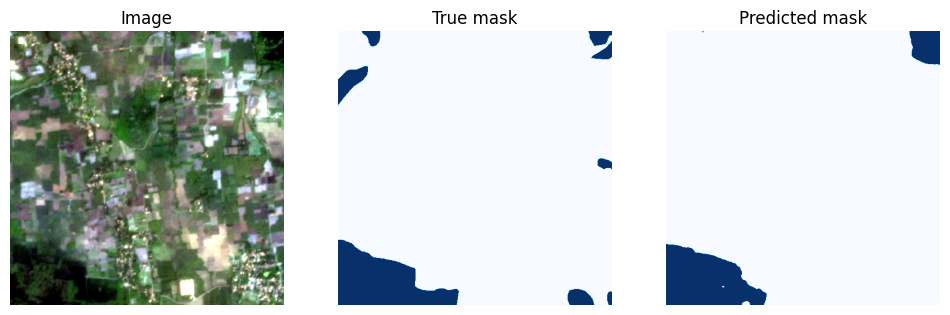

Validation image #25


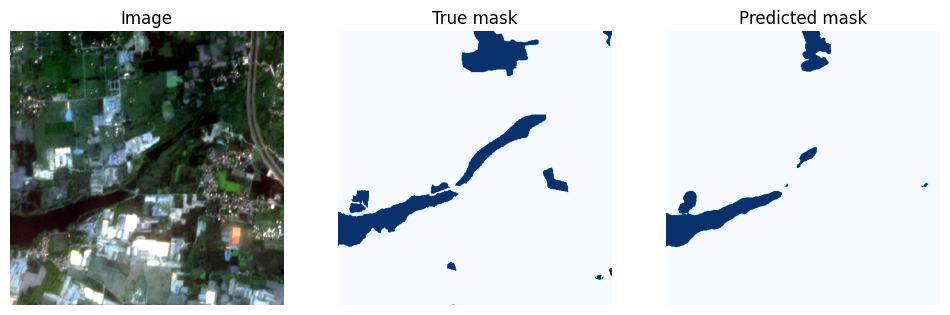

Validation image #26


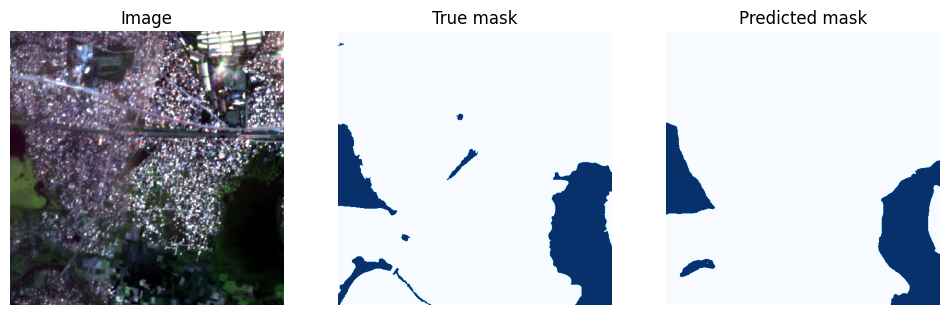

Validation image #27


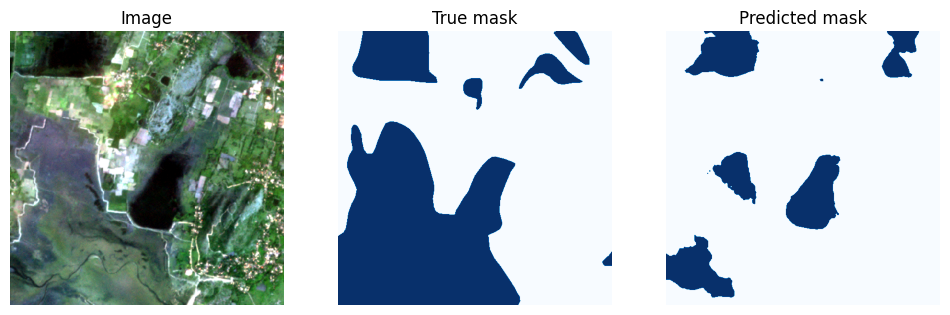

Validation image #28


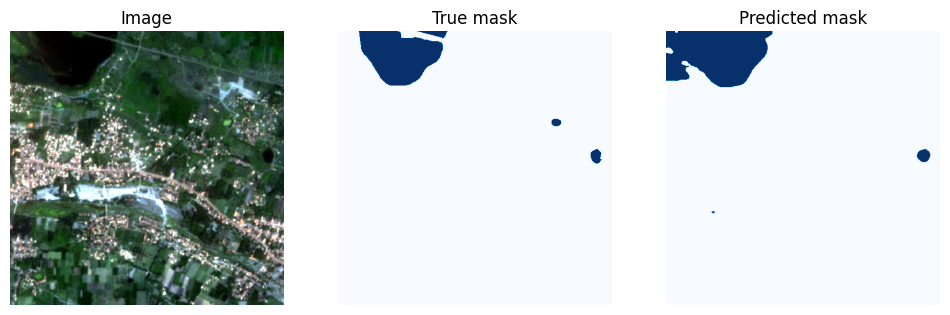

Validation image #29


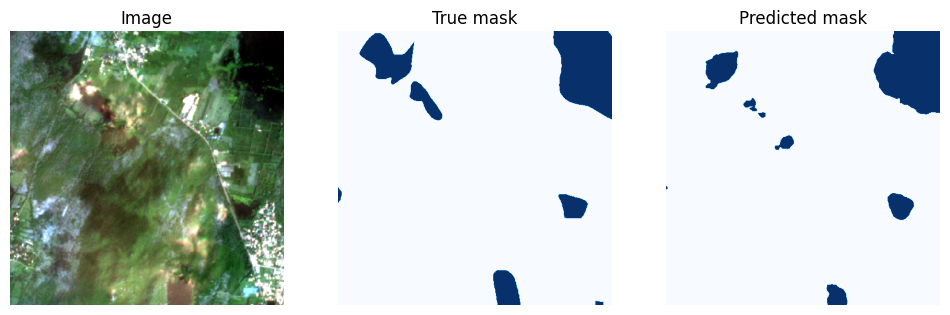

Validation image #30


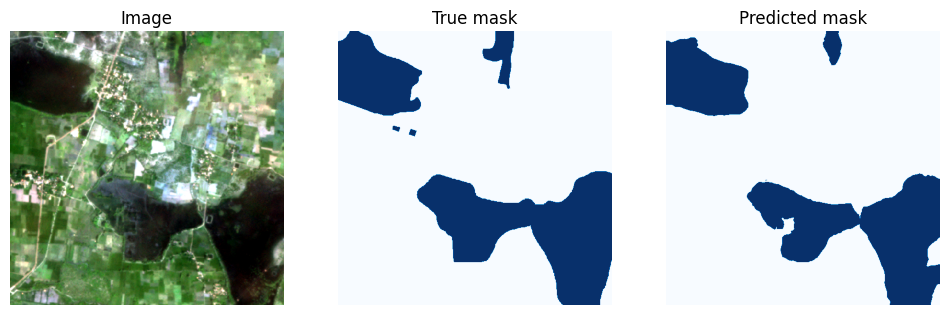

Validation image #31


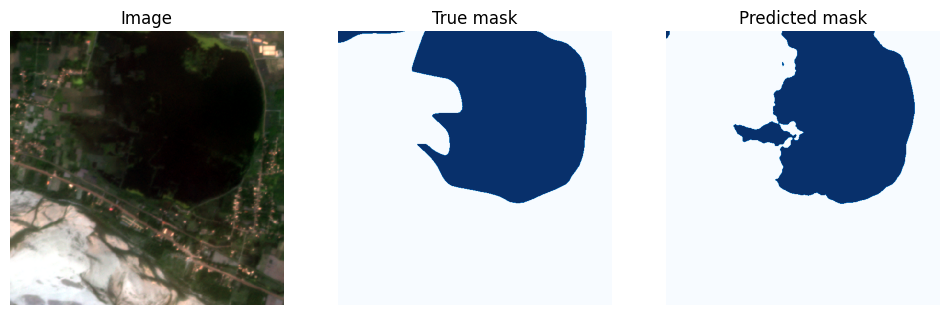

Validation image #32


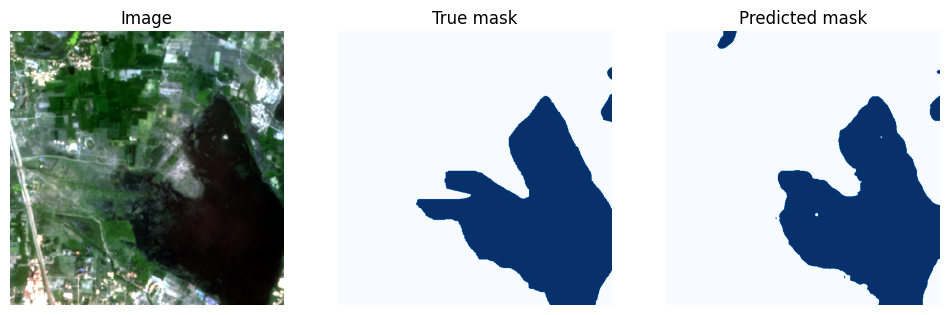

Validation image #33


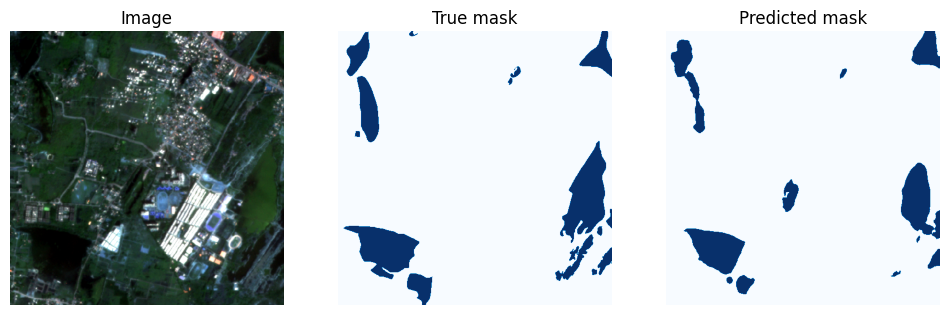

Validation image #34


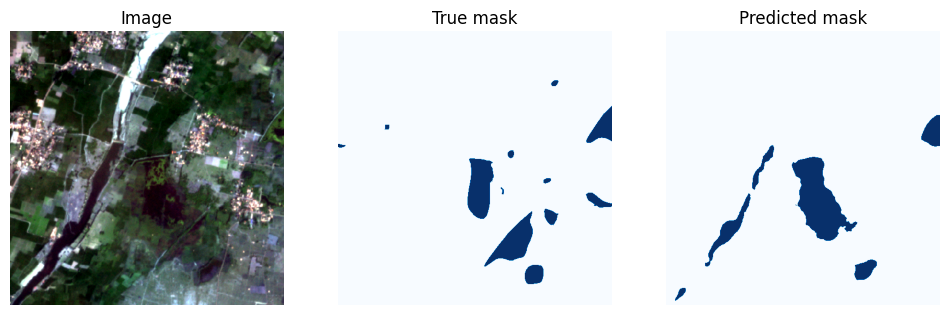

Validation image #35


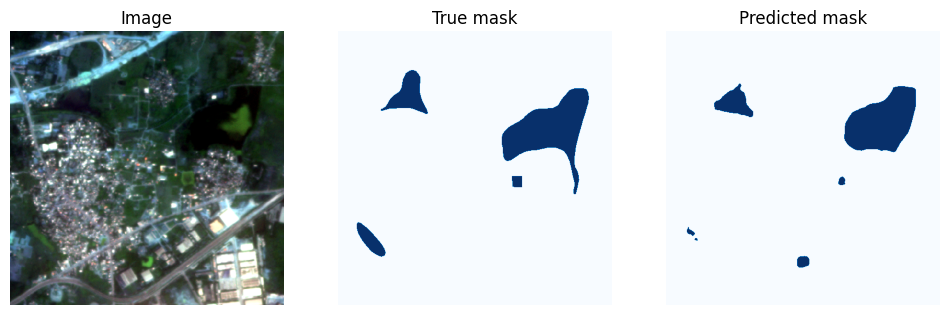

Validation image #36


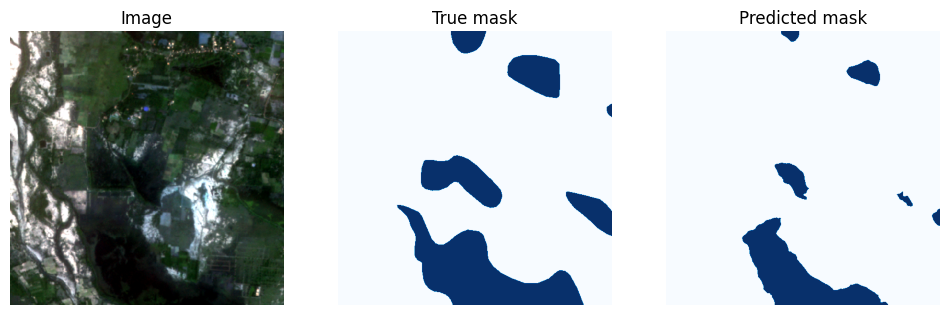

Validation image #37


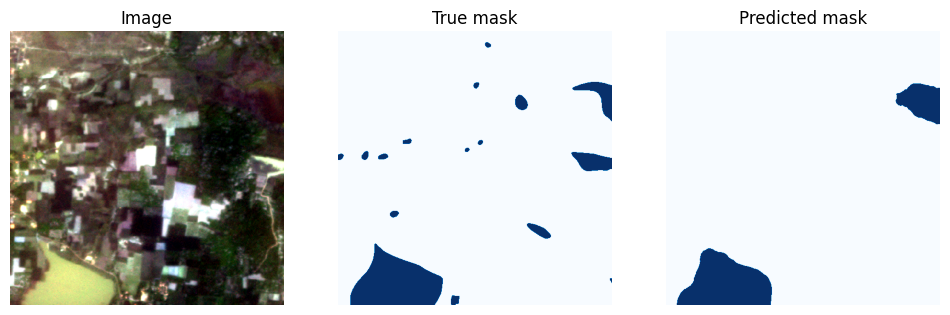

Validation image #38


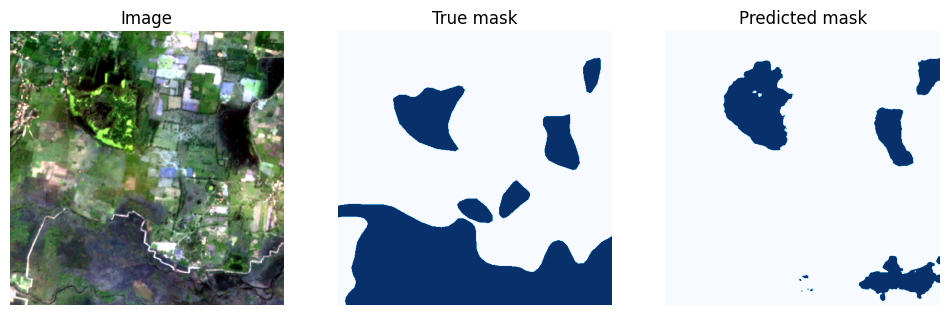

Validation image #39


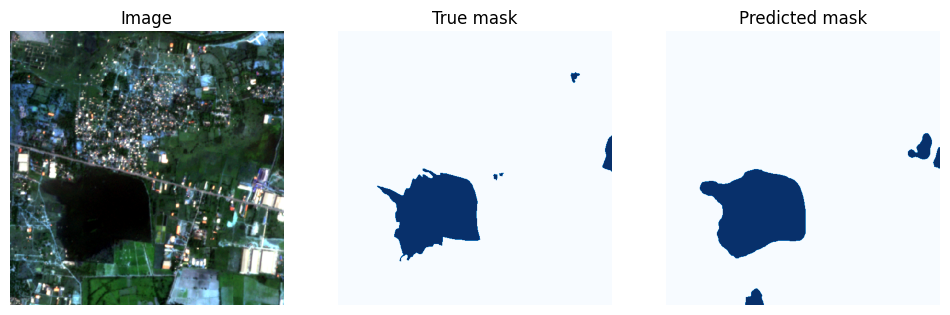

Validation image #40


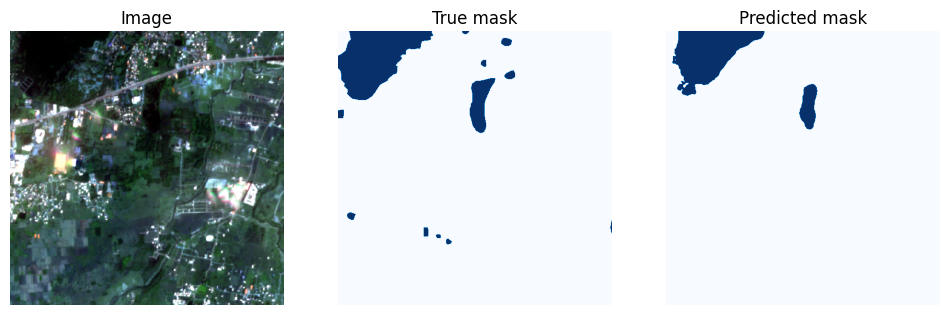

Validation image #41


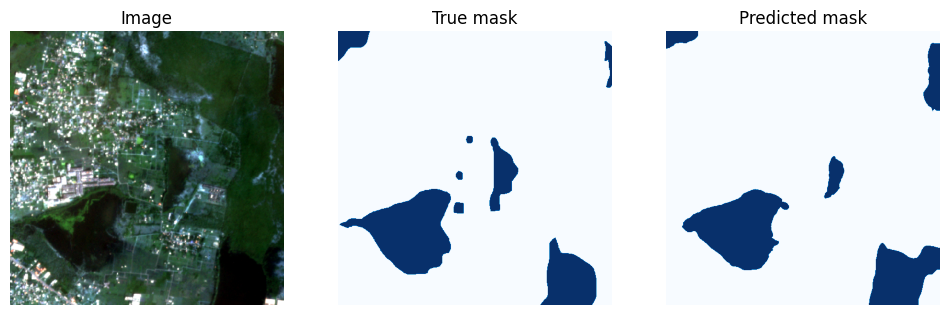

Validation image #42


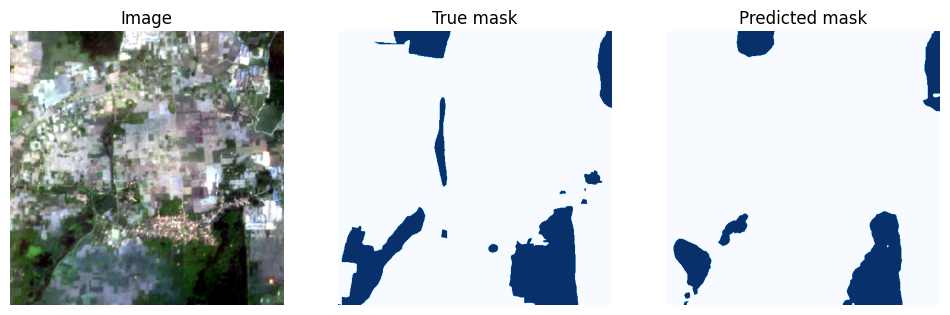

Validation image #43


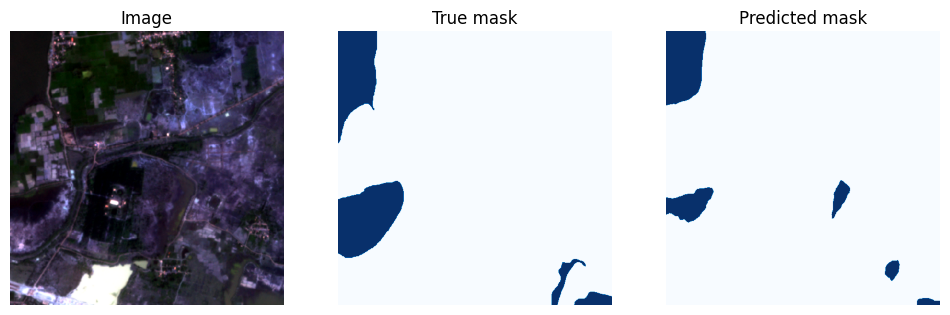

Validation image #44


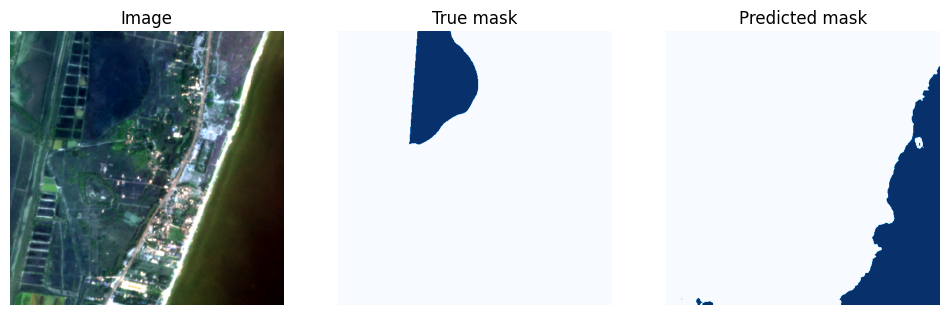

Validation image #45


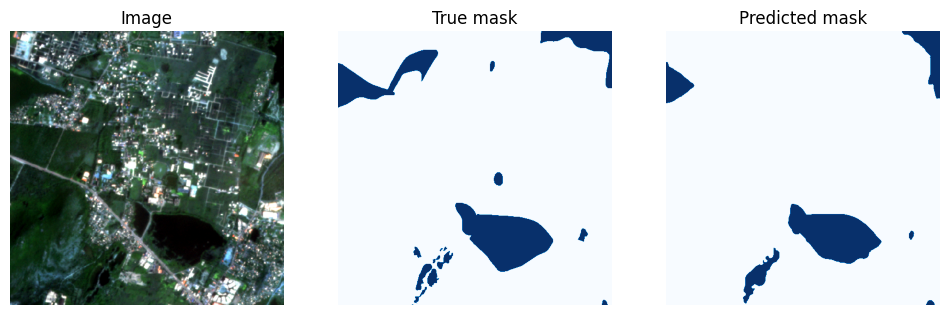

Validation image #46


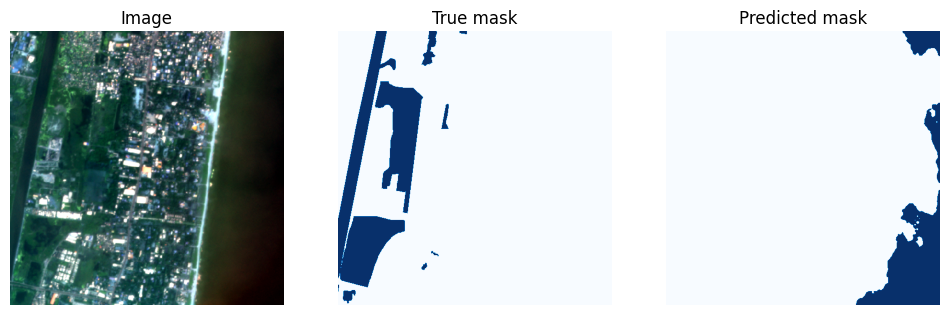

Validation image #47


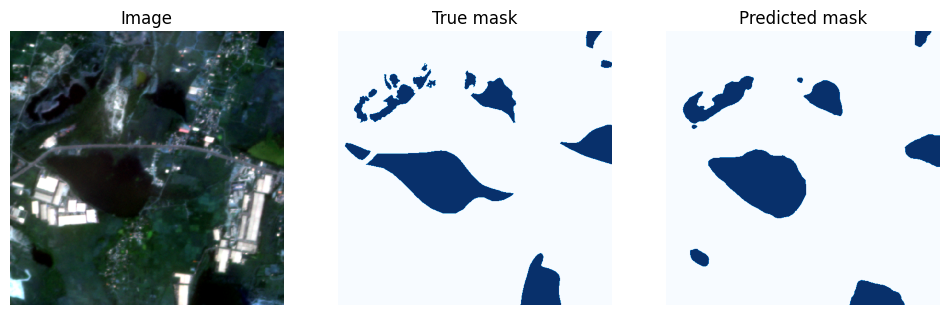

Validation image #48


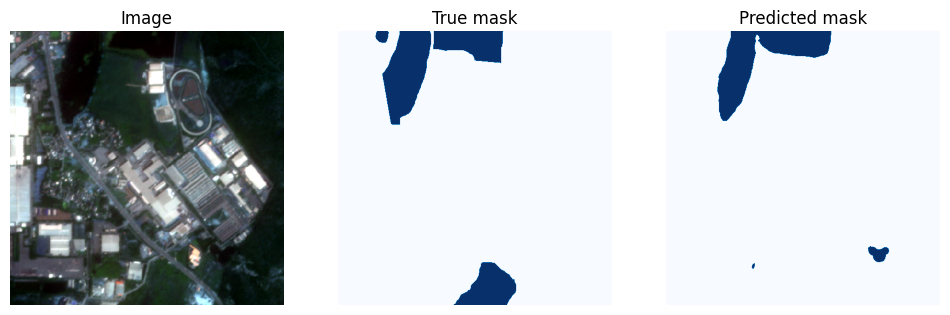

Validation image #49


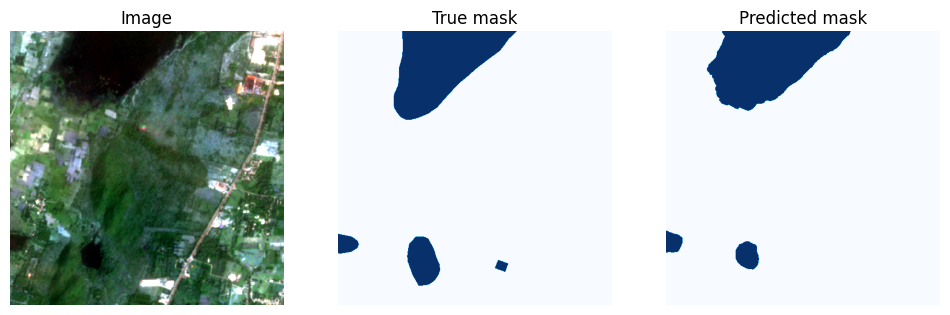

Validation image #50


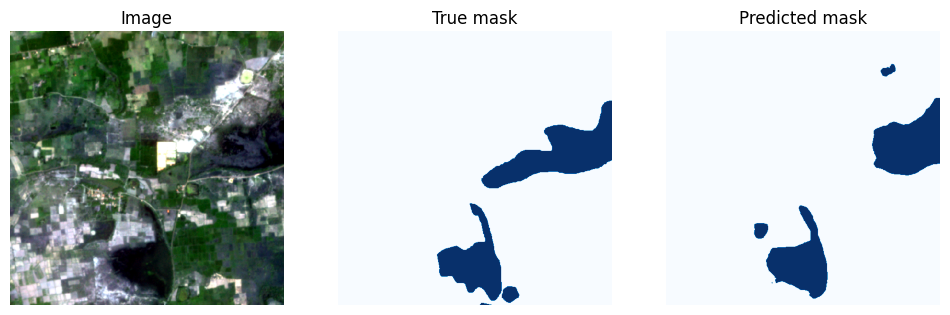

Validation image #51


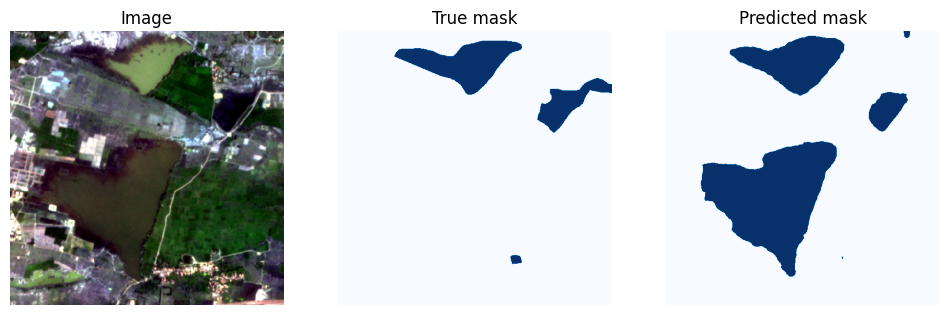

Validation image #52


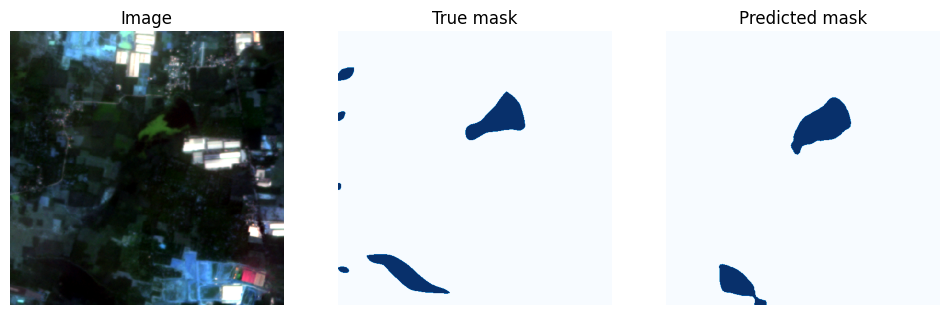

Validation image #53


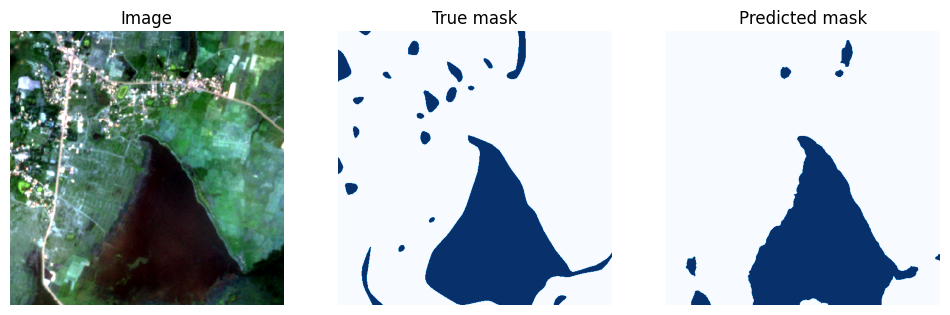

Validation image #54


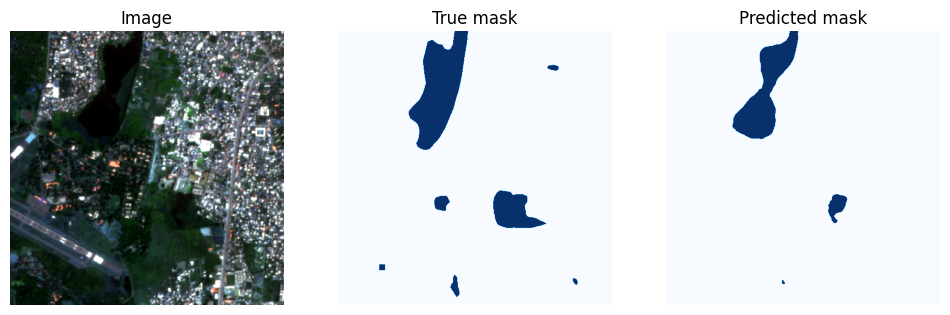

Validation image #55


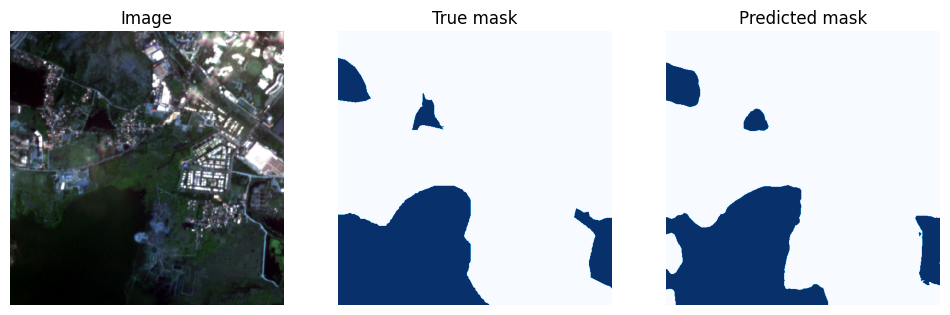

Validation image #56


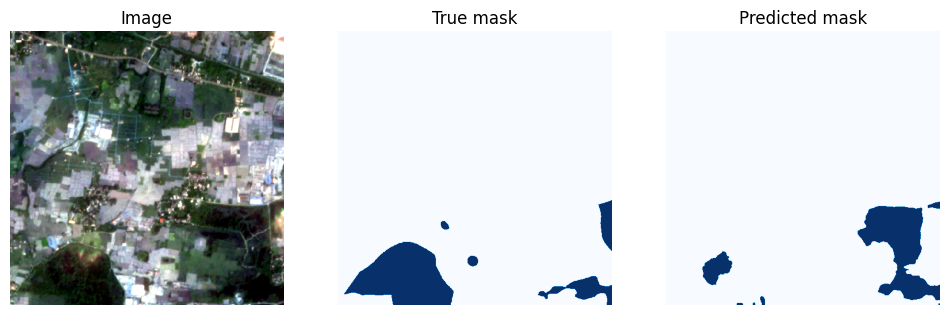

Validation image #57


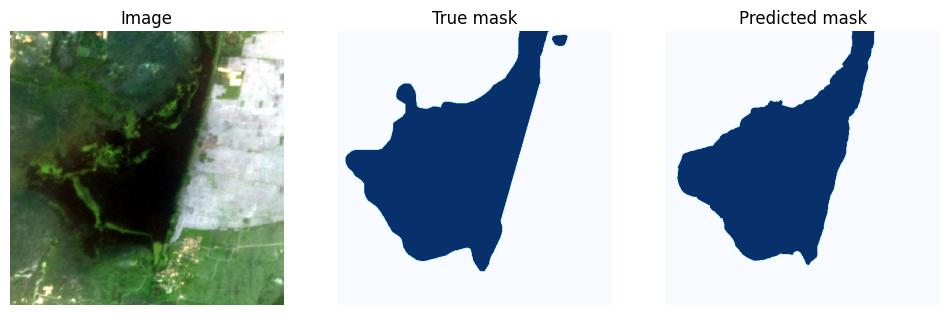

Validation image #58


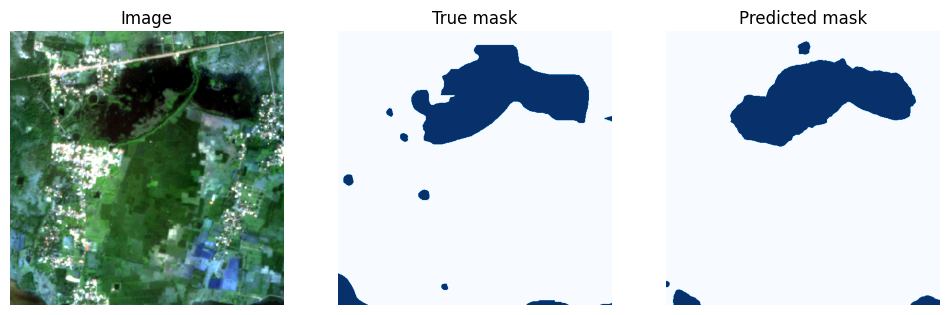

Validation image #59


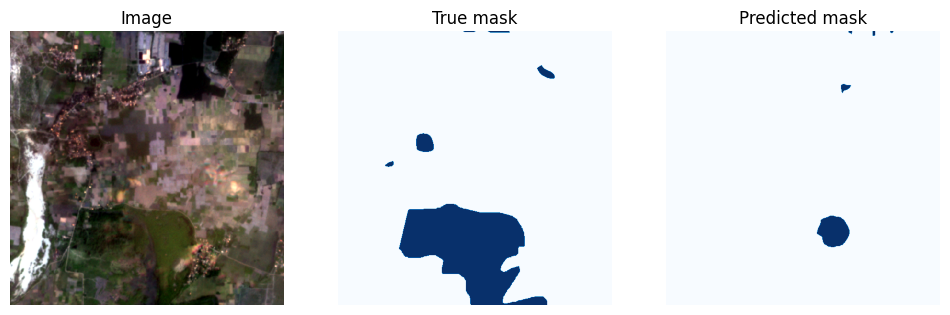

Validation image #60


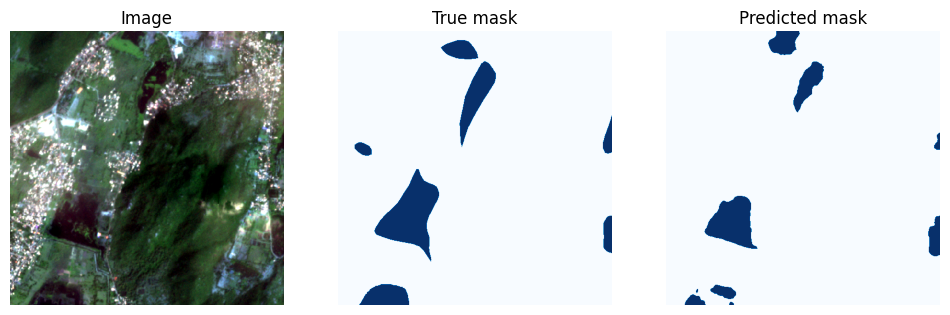

Validation image #61


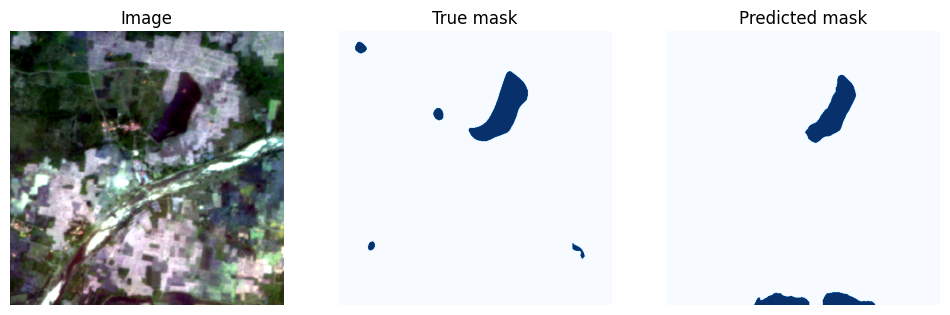

Validation image #62


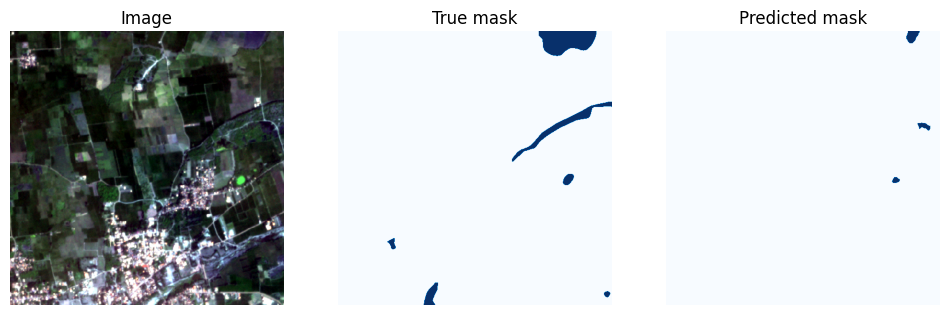

Validation image #63


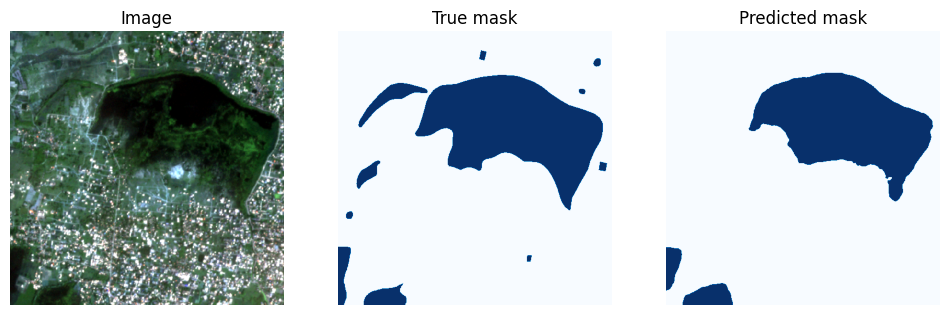

Validation image #64


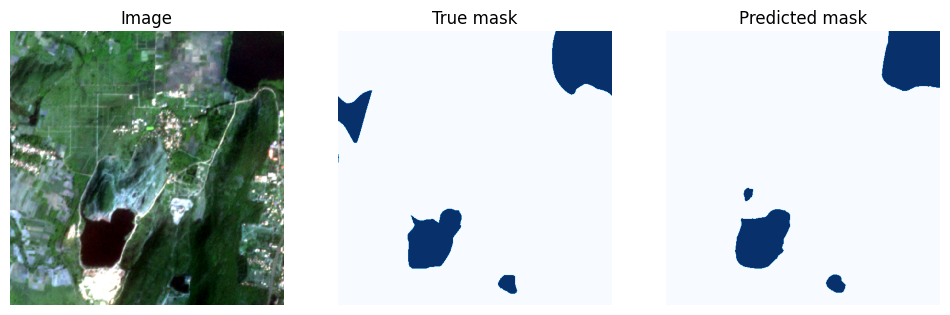

Validation image #65


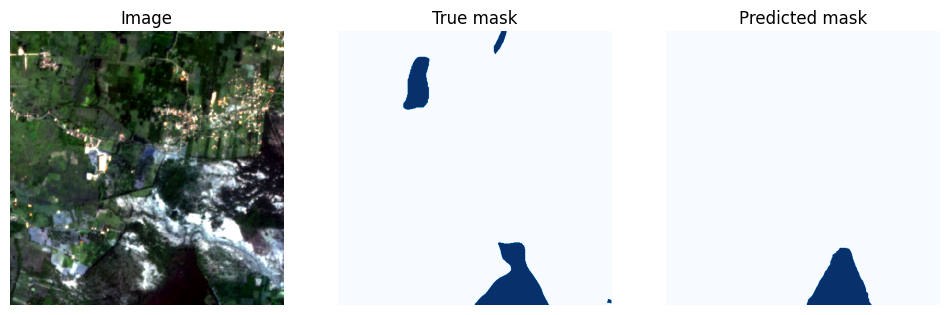

Validation image #66


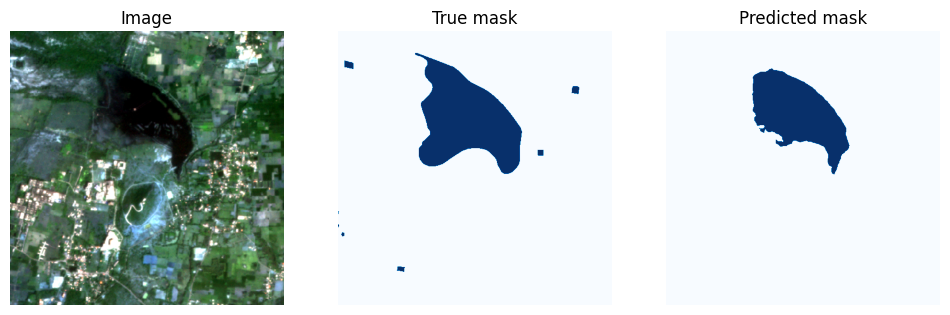

Validation image #67


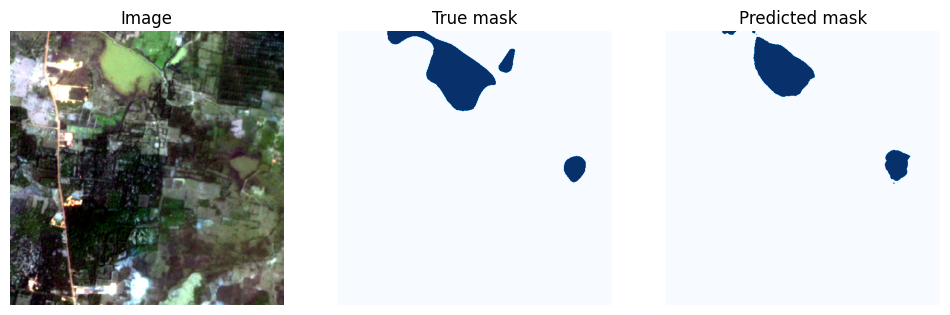

Validation image #68


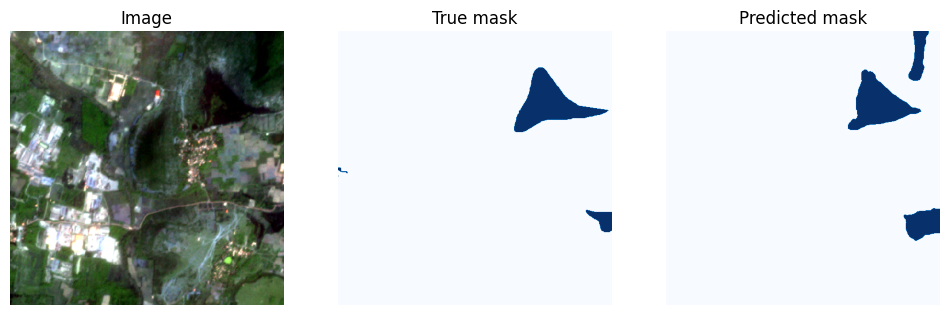

Validation image #69


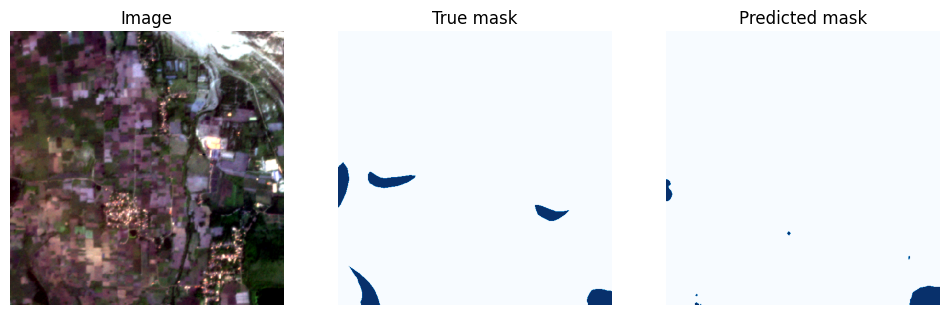

Validation image #70


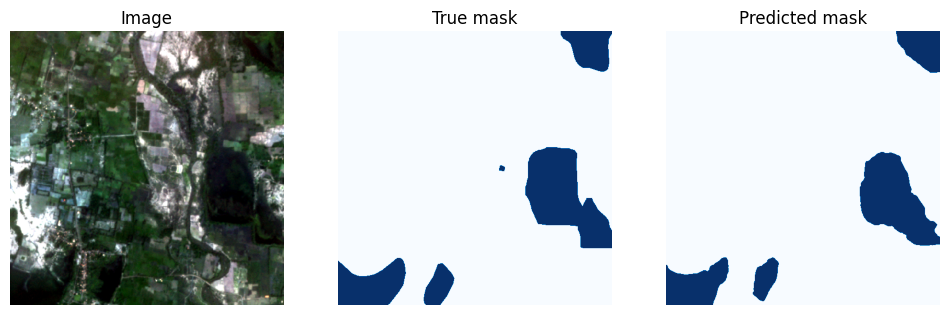

Validation image #71


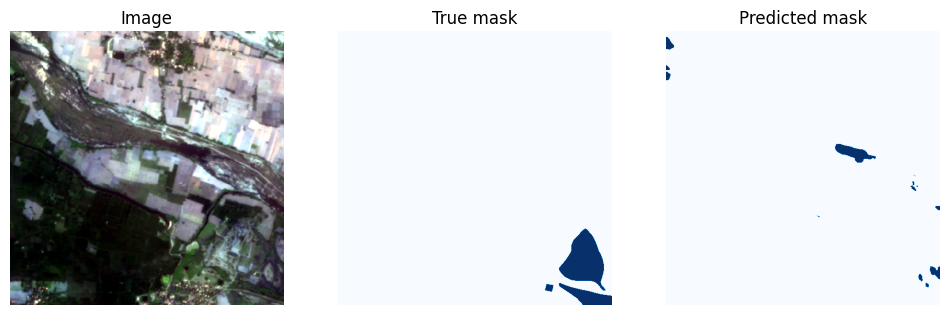

Validation image #72


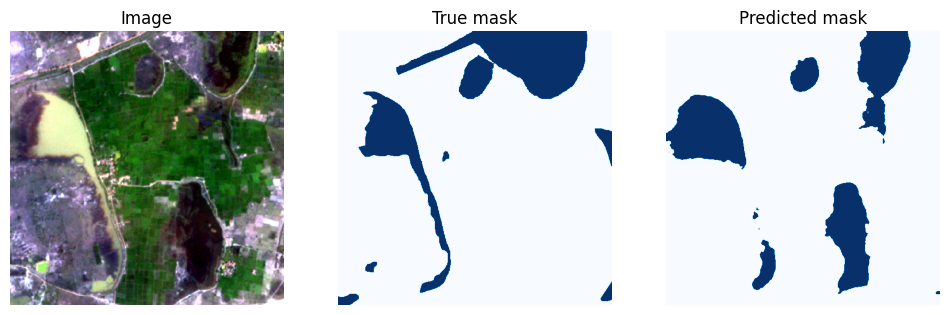

Validation image #73


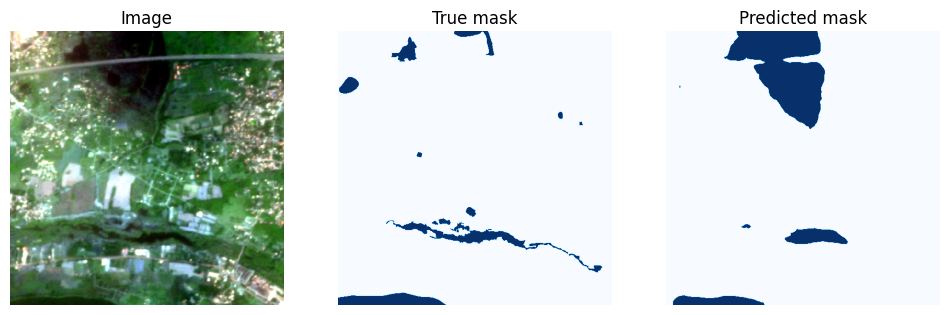

Validation image #74


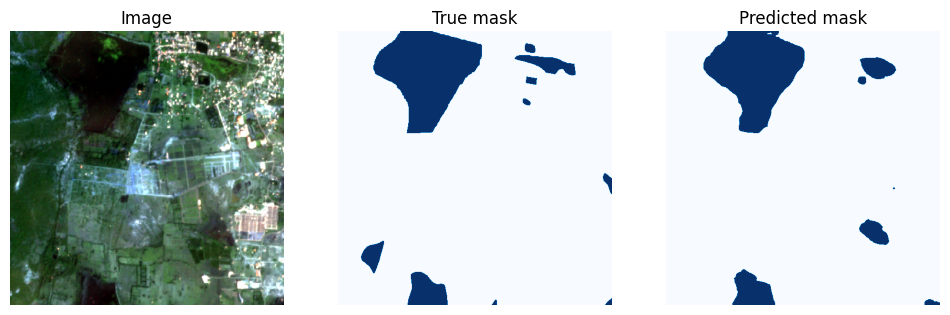

Validation image #75


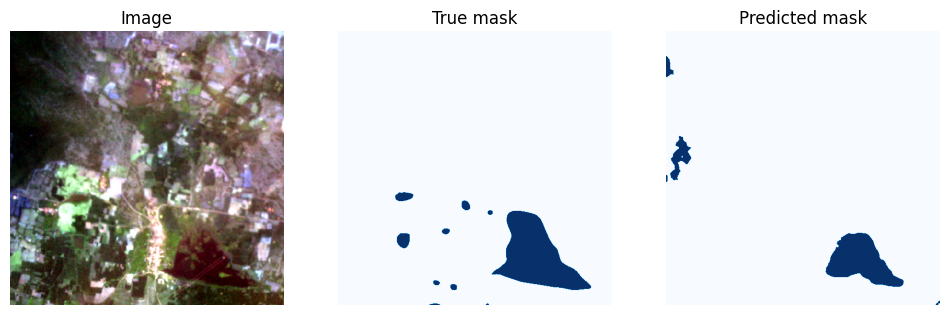

Validation image #76


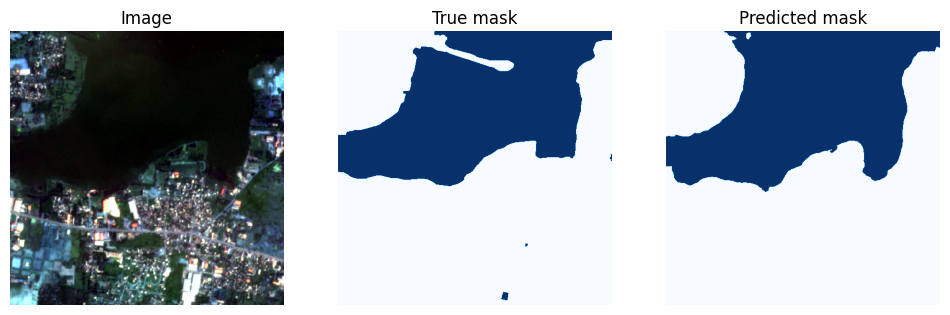

Validation image #77


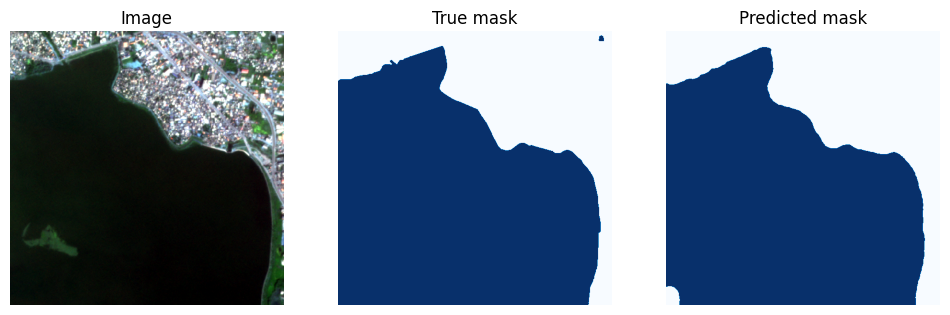

Validation image #78


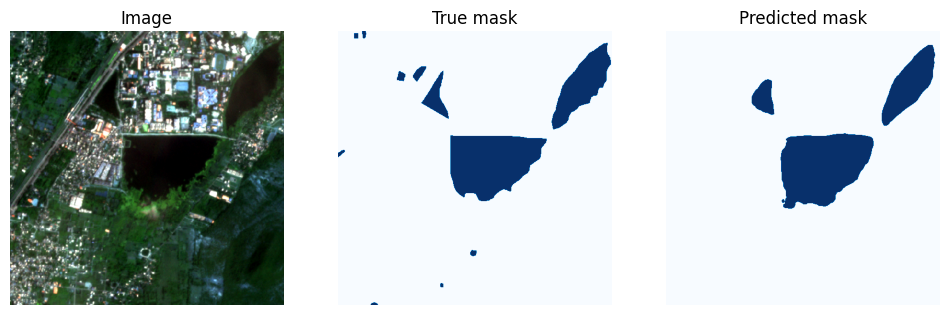

Validation image #79


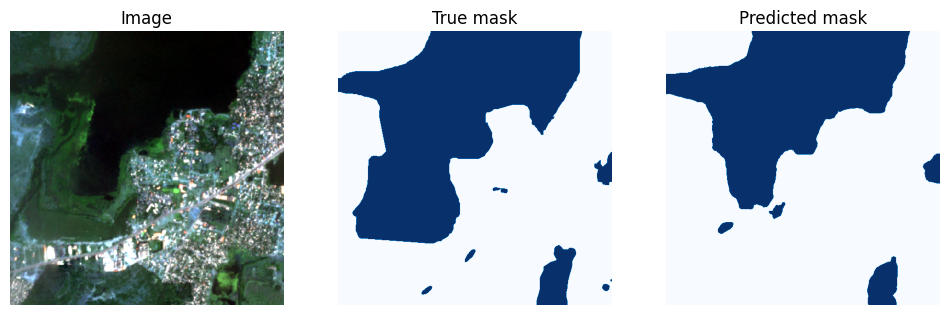

Validation image #80


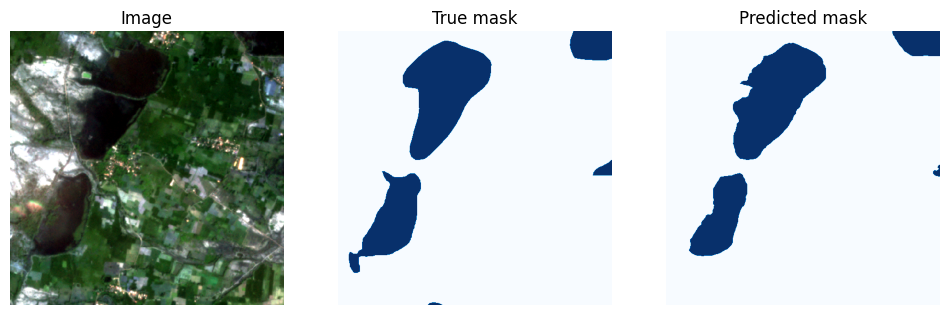

Validation image #81


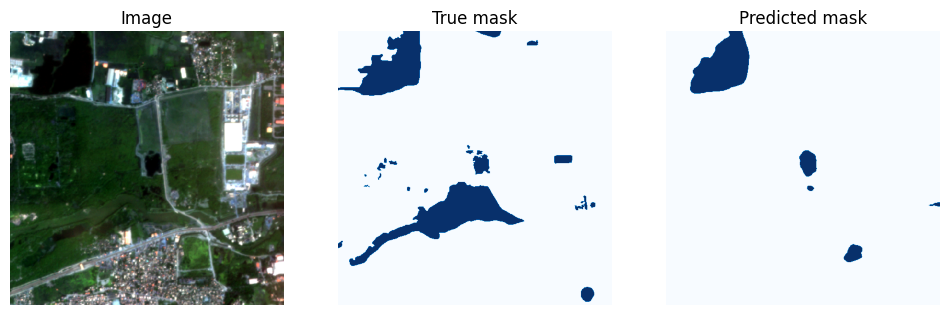

Validation image #82


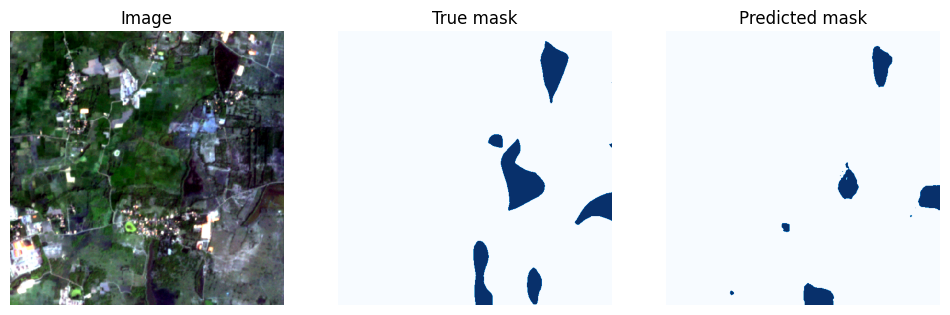

Validation image #83


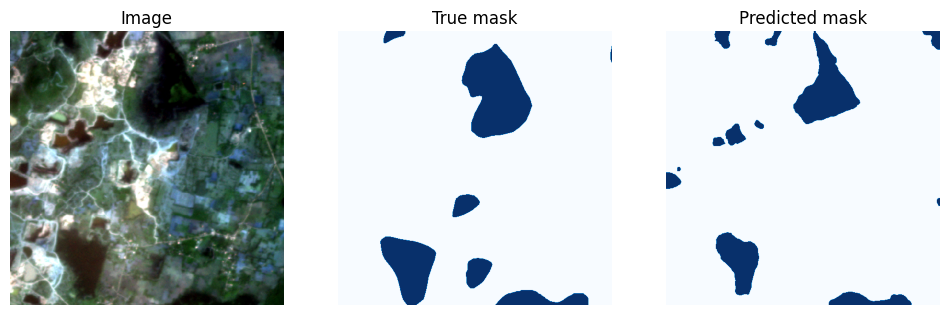

Validation image #84


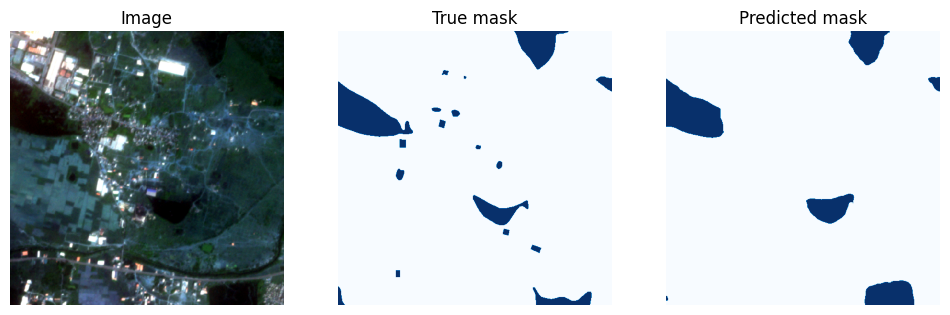

Validation image #85


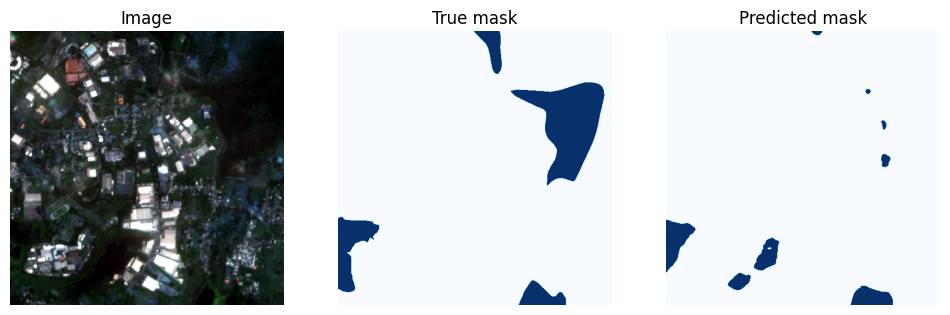

Validation image #86


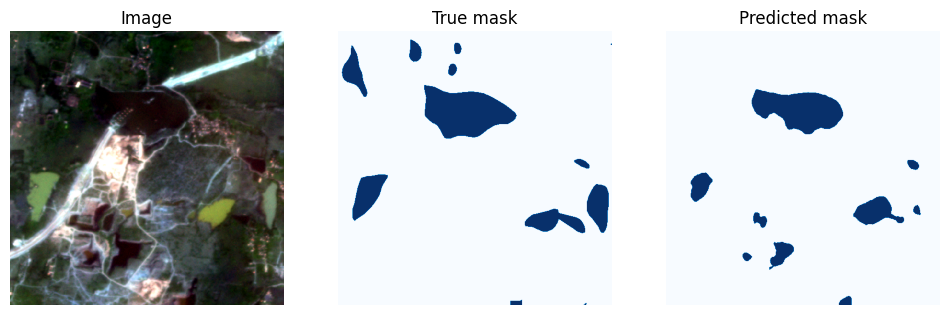

Validation image #87


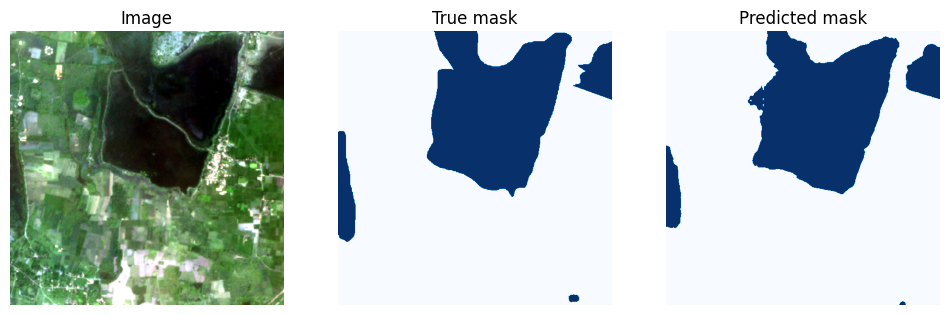

Validation image #88


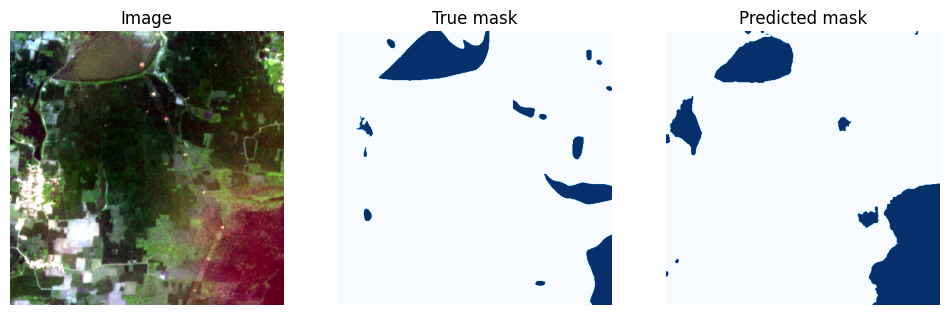

Validation image #89


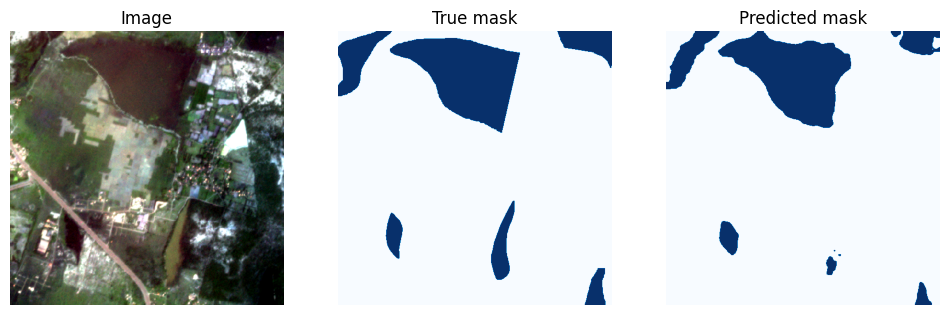

Validation image #90


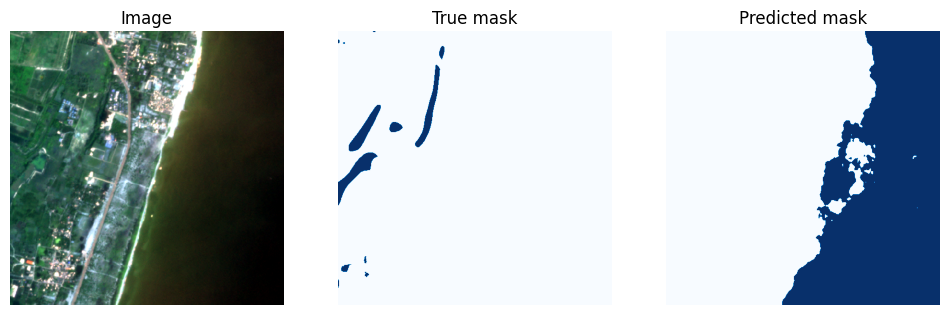

Validation image #91


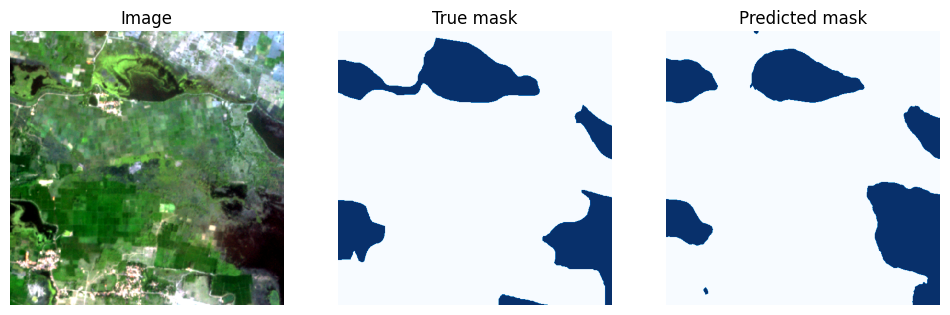

Validation image #92


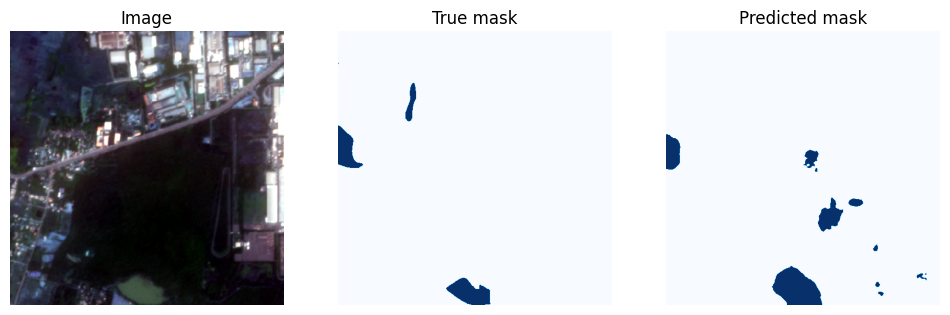

Validation image #93


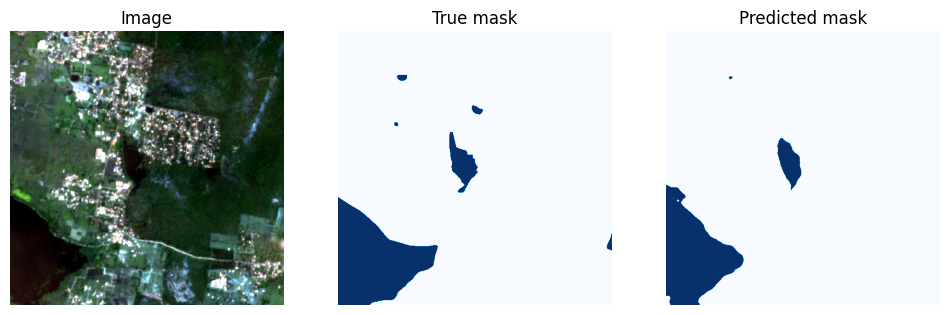

Validation image #94


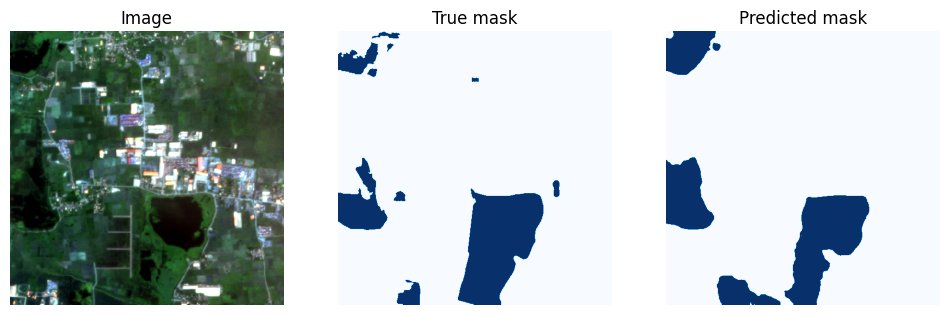

Validation image #95


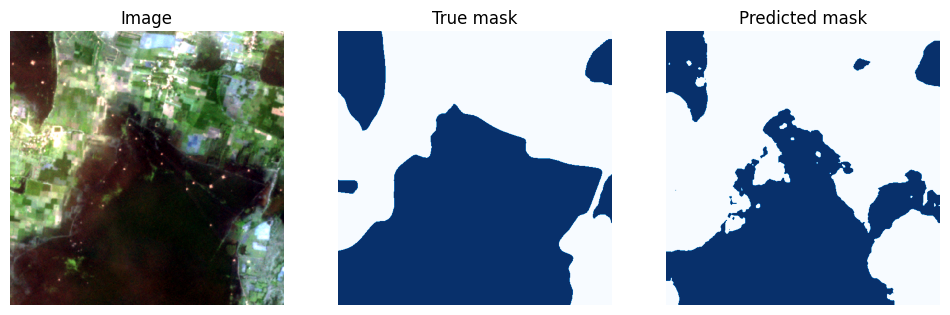

Validation image #96


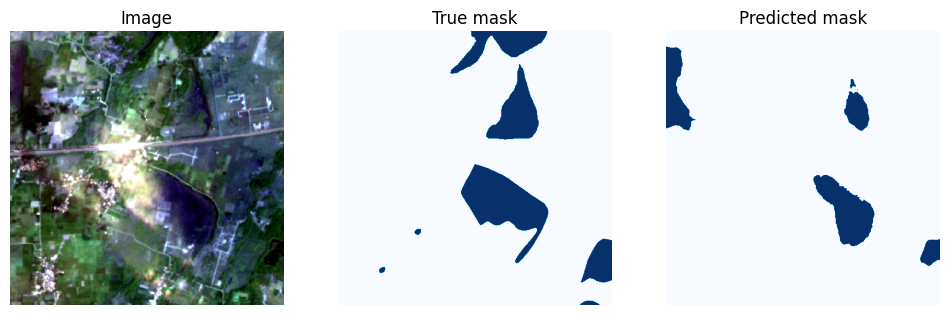

Validation image #97


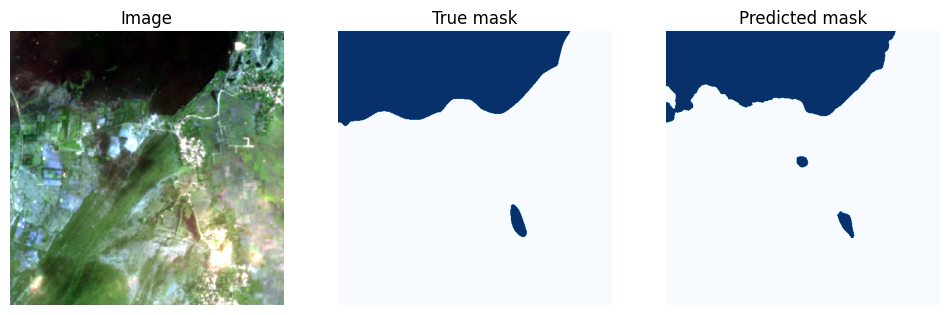

Validation image #98


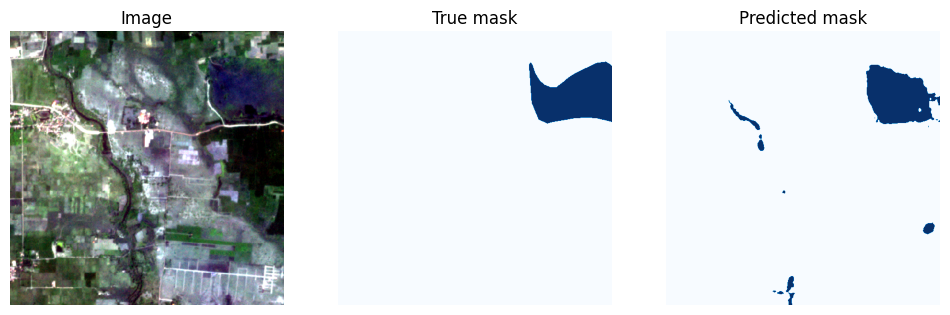

Validation image #99


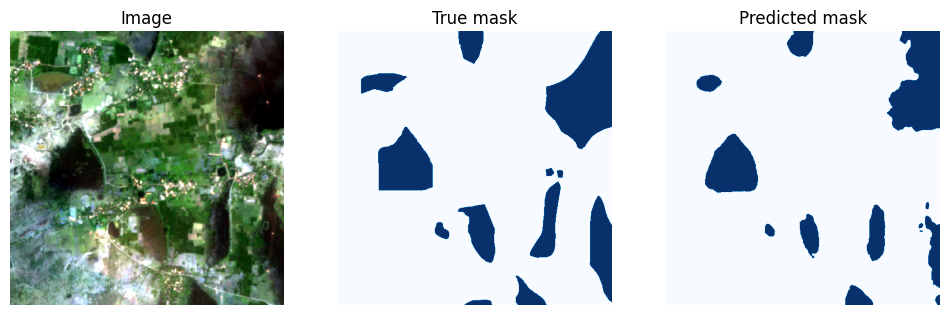

Validation image #100


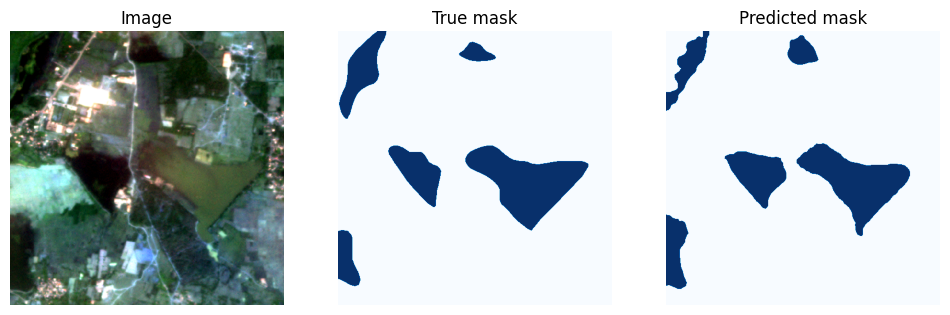

Validation image #101


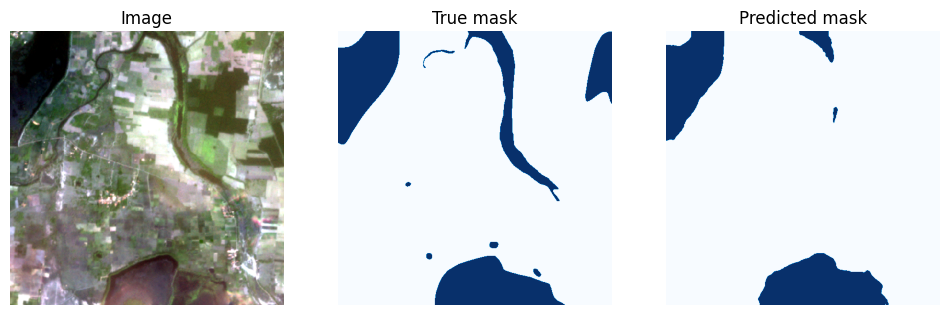

Validation image #102


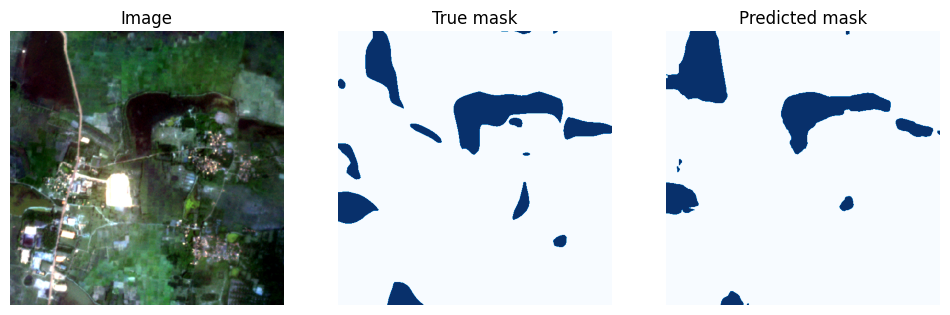

Validation image #103


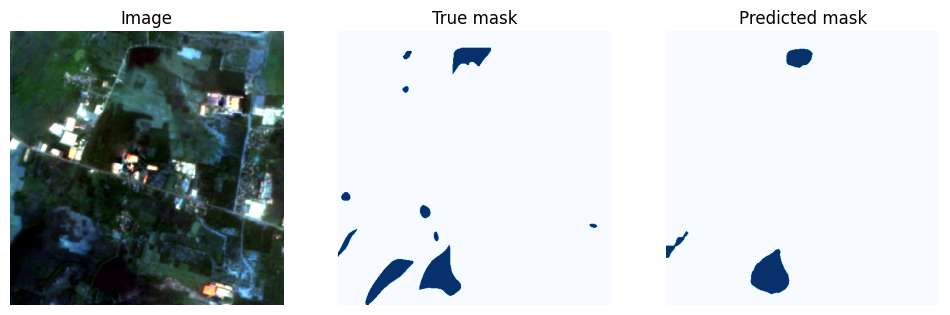

Validation image #104


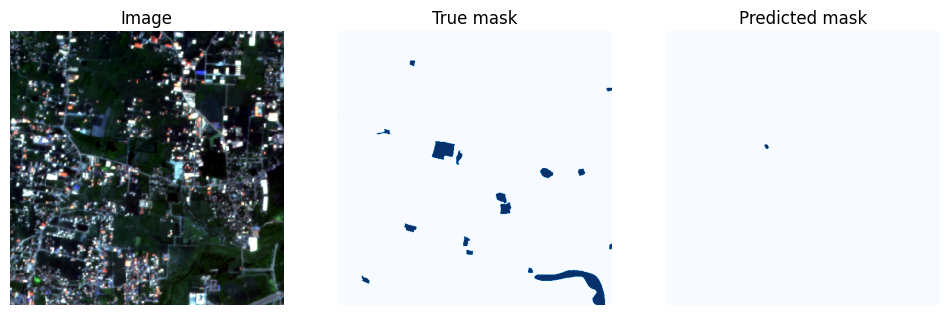

Validation image #105


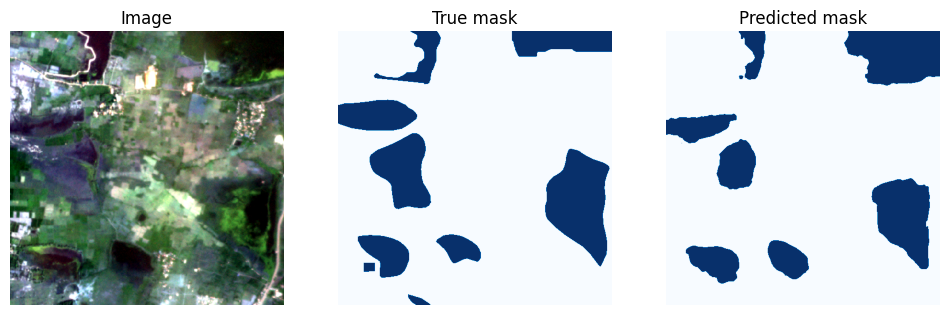

Validation image #106


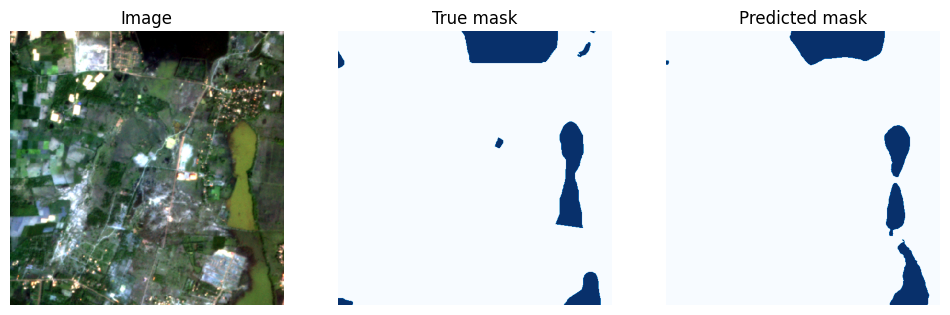

Validation image #107


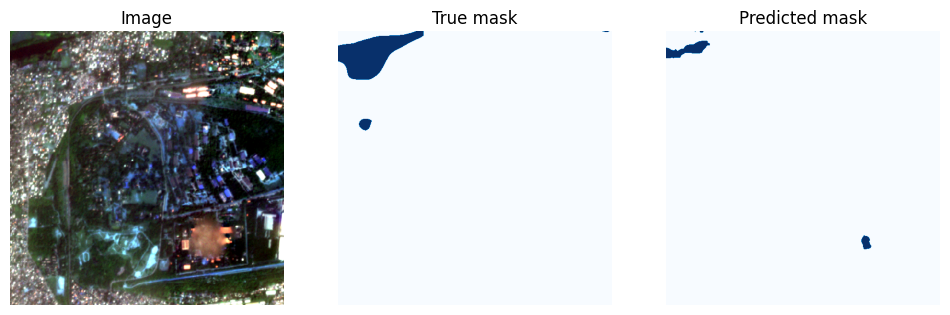

Validation image #108


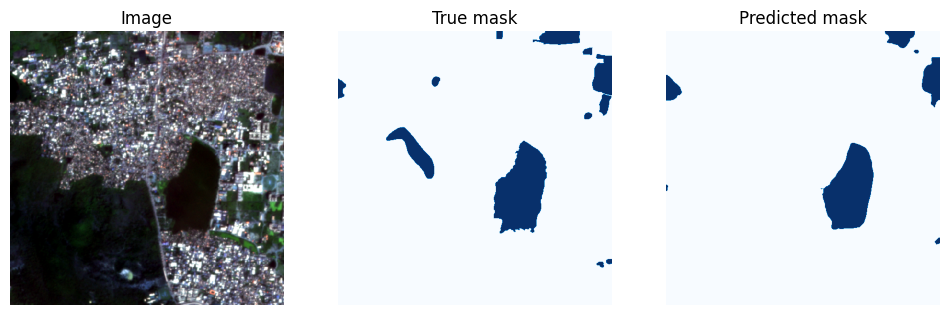

Validation image #109


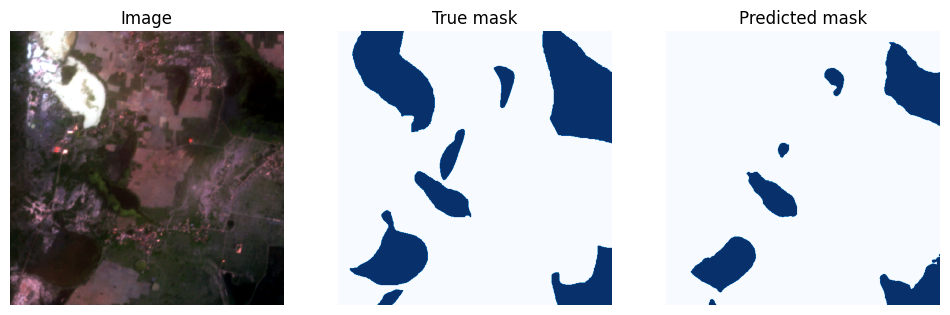

Validation image #110


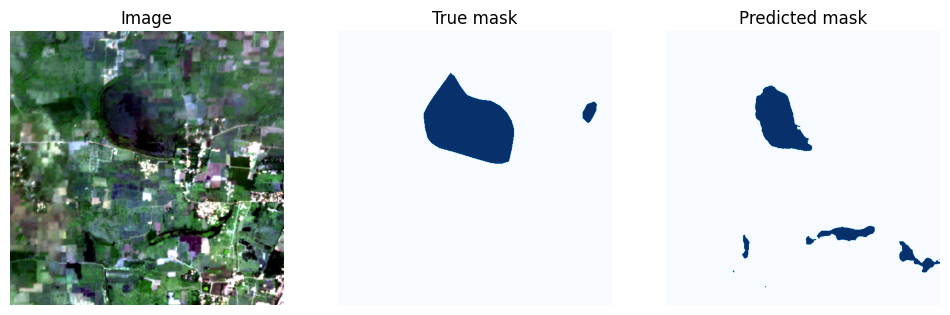

Validation image #111


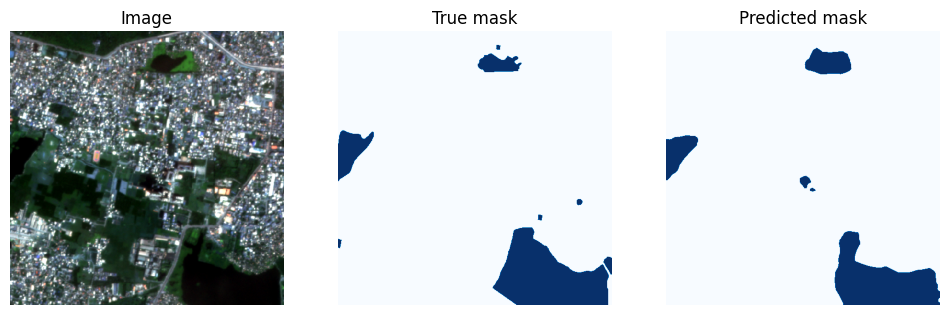

Validation image #112


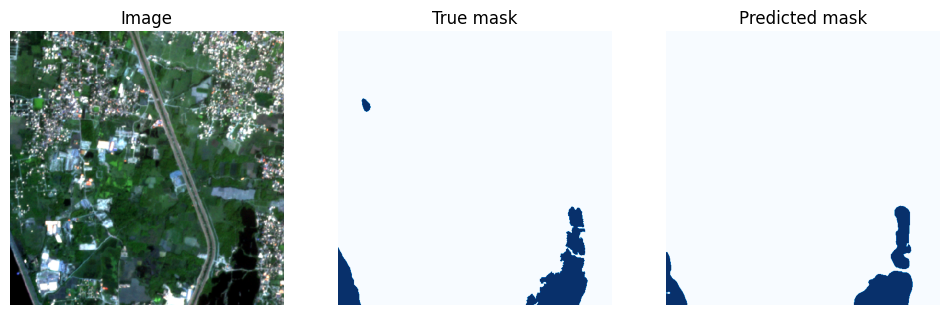

Validation image #113


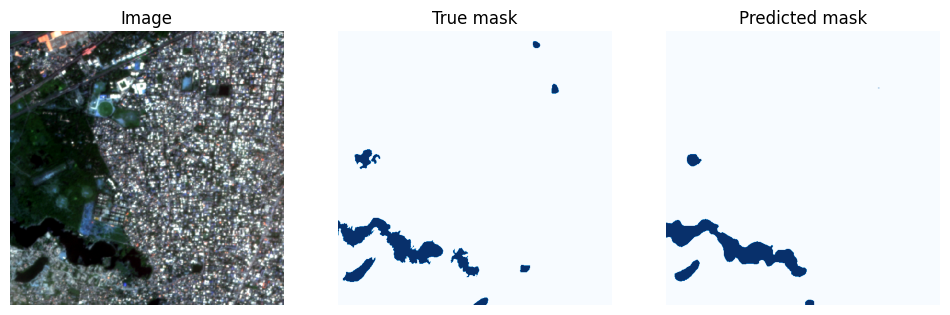

Validation image #114


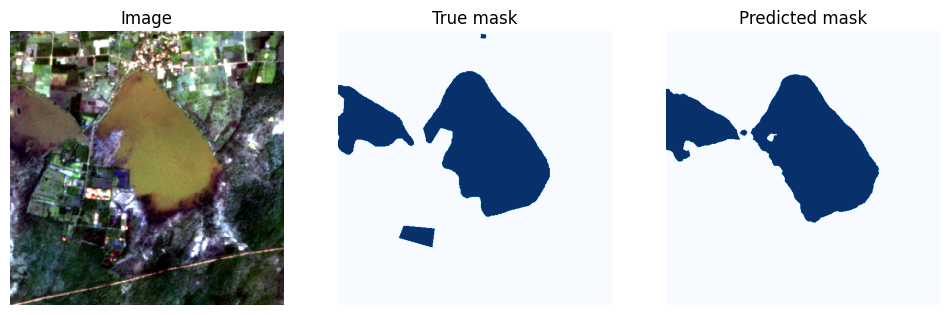

In [ ]:
for i in range(len(val_images)):
    image_path = val_images[i]
    mask_path = val_masks[i]

    image = tifffile.imread(image_path)
    mask = cv2.imread(mask_path, cv2.IMREAD_UNCHANGED)
    print(f'Validation image #{i + 1}')

    inputs = np.moveaxis(image, -1, 0)
    inputs = feature_extractor(images=image, return_tensors='pt')

    outputs = model(**inputs)
    logits = outputs.logits

    # Rescale logits to original image size
    upsampled_logits = nn.functional.interpolate(
        logits,
        size=image.shape[:-1], # (height, width)
        mode='bilinear',
        align_corners=False
    )

    # Apply argmax on the class dimension
    pred_mask = upsampled_logits.argmax(dim=1)[0]


    fig, (ax1, ax2, ax3) = plt.subplots(nrows=1, ncols=3)

    ax1.imshow(image)
    ax1.set_title('Image')
    ax1.axis('Off')

    ax2.imshow(mask, cmap='Blues')
    ax2.set_title('True mask')
    ax2.axis('Off')

    ax3.imshow(pred_mask, cmap='Blues')
    ax3.set_title('Predicted mask')
    ax3.axis('Off')
    plt.show()

In [ ]:
val_images

In [ ]:
val_masks

### predict and save all images

In [ ]:
import os
import numpy as np
import tifffile
import cv2
import matplotlib.pyplot as plt
import torch.nn.functional as nnf
from PIL import Image

def save_predictions(val_images, val_masks, model, feature_extractor, output_folder):
    os.makedirs(output_folder, exist_ok=True)

    for i in range(len(val_images)):
        image_path = val_images[i]
        mask_path = val_masks[i]

        image = tifffile.imread(image_path)
        mask = cv2.imread(mask_path, cv2.IMREAD_UNCHANGED)
        print(f'Validation image #{i + 1}')

        inputs = np.moveaxis(image, -1, 0)
        inputs = feature_extractor(images=image, return_tensors='pt')

        outputs = model(**inputs)
        logits = outputs.logits

        # Rescale logits to original image size
        upsampled_logits = nnf.interpolate(
            logits,
            size=image.shape[:-1], # (height, width)
            mode='bilinear',
            align_corners=False
        )

        # Apply argmax on the class dimension
        pred_mask = upsampled_logits.argmax(dim=1)[0].cpu().numpy()

        # Create the output file path with '_pred' attached to the original mask name
        mask_name = os.path.basename(mask_path)
        mask_name_without_ext, ext = os.path.splitext(mask_name)
        pred_mask_name = f"{mask_name_without_ext}_pred.png"
        pred_mask_path = os.path.join(output_folder, pred_mask_name)

        # Save the predicted mask as a PNG file
        pred_mask_image = Image.fromarray(pred_mask.astype(np.uint8))
        pred_mask_image.save(pred_mask_path)

        # Display the images and masks
        fig, (ax1, ax2, ax3) = plt.subplots(nrows=1, ncols=3)

        ax1.imshow(image)
        ax1.set_title('Image')
        ax1.axis('Off')

        ax2.imshow(mask, cmap='Blues')
        ax2.set_title('True mask')
        ax2.axis('Off')

        ax3.imshow(pred_mask, cmap='Blues')
        ax3.set_title('Predicted mask')
        ax3.axis('Off')

        plt.show()


output_folder = "/content/drive/MyDrive/MA/Output/Prediction_masks"


save_predictions(val_images, val_masks, model, feature_extractor, output_folder)